# **"Prediccion de la rotacion de empleados".**


![ROTACION lABORAL](../NOTEBOOKS/1955-Portada-analisis-de-la-fuerza-de-trabajo.jpg)


## Objetivo:

### Comprender los factores que influyen en la deserción de los empleados en la empresa y encontrar posibles soluciones para reducir la tasa de deserción .


#### Comenzamos importando las librerias necesarias para el analisis


In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from ydata_profiling import ProfileReport


#### Cargar archivos CSV en DataFrames


In [2]:
df1 = pd.read_csv(
    r'C:\Users\Jholman Cuartas\Desktop\proyecto grupo 3\aug_test.csv')
df2 = pd.read_csv(
    r'C:\Users\Jholman Cuartas\Desktop\proyecto grupo 3\aug_train.csv')
df3 = pd.read_csv(
    r'C:\Users\Jholman Cuartas\Desktop\proyecto grupo 3\sample_submission.csv')
df4 = pd.read_csv(
    r'C:\Users\Jholman Cuartas\Desktop\proyecto grupo 3\HR-Employee-Attrition.csv')


##### Leer el conjunto de datos de los DataFrame y Mostrar las primeras filas y sus columnas


In [3]:
# Leer el conjunto de datos df1
df1 = pd.read_csv(
    r'C:\Users\Jholman Cuartas\Desktop\proyecto grupo 3\aug_test.csv')

# Obtener los nombres de las columnas de df1
columnas_df1 = df1.columns
print("Columnas del DataFrame df1:")
print(columnas_df1)

# Mostrar las primeras filas de df1
print("\nPrimeras filas del DataFrame df1:")
print(df1.head())


Columnas del DataFrame df1:
Index(['enrollee_id', 'city', 'city_development_index', 'gender',
       'relevent_experience', 'enrolled_university', 'education_level',
       'major_discipline', 'experience', 'company_size', 'company_type',
       'last_new_job', 'training_hours'],
      dtype='object')

Primeras filas del DataFrame df1:
   enrollee_id      city  city_development_index  gender  \
0        32403   city_41                   0.827    Male   
1         9858  city_103                   0.920  Female   
2        31806   city_21                   0.624    Male   
3        27385   city_13                   0.827    Male   
4        27724  city_103                   0.920    Male   

       relevent_experience enrolled_university education_level  \
0  Has relevent experience    Full time course        Graduate   
1  Has relevent experience       no_enrollment        Graduate   
2   No relevent experience       no_enrollment     High School   
3  Has relevent experience       no_e

In [4]:
# Leer el conjunto de datos df2
df2 = pd.read_csv(
    r'C:\Users\Jholman Cuartas\Desktop\proyecto grupo 3\aug_train.csv')

# Obtener los nombres de las columnas de df2
columnas_df2 = df2.columns
print("\n\nColumnas del DataFrame df2:")
print(columnas_df2)

# Mostrar las primeras filas de df2
print("\nPrimeras filas del DataFrame df2:")
print(df2.head())




Columnas del DataFrame df2:
Index(['enrollee_id', 'city', 'city_development_index', 'gender',
       'relevent_experience', 'enrolled_university', 'education_level',
       'major_discipline', 'experience', 'company_size', 'company_type',
       'last_new_job', 'training_hours', 'target'],
      dtype='object')

Primeras filas del DataFrame df2:
   enrollee_id      city  city_development_index gender  \
0         8949  city_103                   0.920   Male   
1        29725   city_40                   0.776   Male   
2        11561   city_21                   0.624    NaN   
3        33241  city_115                   0.789    NaN   
4          666  city_162                   0.767   Male   

       relevent_experience enrolled_university education_level  \
0  Has relevent experience       no_enrollment        Graduate   
1   No relevent experience       no_enrollment        Graduate   
2   No relevent experience    Full time course        Graduate   
3   No relevent experience     

In [5]:
# Leer el conjunto de datos df3
df3 = pd.read_csv(
    r'C:\Users\Jholman Cuartas\Desktop\proyecto grupo 3\sample_submission.csv')

# Obtener los nombres de las columnas de df3
columnas_df3 = df3.columns
print("\n\nColumnas del DataFrame df3:")
print(columnas_df3)

# Mostrar las primeras filas de df3
print("\nPrimeras filas del DataFrame df3:")
print(df3.head())




Columnas del DataFrame df3:
Index(['enrollee_id', 'target'], dtype='object')

Primeras filas del DataFrame df3:
   enrollee_id  target
0        32403     0.5
1         9858     0.5
2        31806     0.5
3        27385     0.5
4        27724     0.5


In [6]:
# Leer el conjunto de datos df4
df4 = pd.read_csv(
    r'C:\Users\Jholman Cuartas\Desktop\proyecto grupo 3\HR-Employee-Attrition.csv')
# Obtener los nombres de las columnas de df4
columnas_df4 = df4.columns
print("\n\nColumnas del DataFrame df4:")
print(columnas_df4)

# Mostrar las primeras filas de df4
print("\nPrimeras filas del DataFrame df4:")
print(df4.head())




Columnas del DataFrame df4:
Index(['Age', 'Attrition', 'BusinessTravel', 'DailyRate', 'Department',
       'DistanceFromHome', 'Education', 'EducationField', 'EmployeeCount',
       'EmployeeNumber', 'EnvironmentSatisfaction', 'Gender', 'HourlyRate',
       'JobInvolvement', 'JobLevel', 'JobRole', 'JobSatisfaction',
       'MaritalStatus', 'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked',
       'Over18', 'OverTime', 'PercentSalaryHike', 'PerformanceRating',
       'RelationshipSatisfaction', 'StandardHours', 'StockOptionLevel',
       'TotalWorkingYears', 'TrainingTimesLastYear', 'WorkLifeBalance',
       'YearsAtCompany', 'YearsInCurrentRole', 'YearsSinceLastPromotion',
       'YearsWithCurrManager'],
      dtype='object')

Primeras filas del DataFrame df4:
   Age Attrition     BusinessTravel  DailyRate              Department  \
0   41       Yes      Travel_Rarely       1102                   Sales   
1   49        No  Travel_Frequently        279  Research & Development   
2 

##### Obtener estadísticas descriptivas de las columnas numéricas de df1


In [7]:
print("\nEstadísticas descriptivas de df1:")
print(df1.describe())



Estadísticas descriptivas de df1:
        enrollee_id  city_development_index  training_hours
count   2129.000000             2129.000000     2129.000000
mean   16861.614843                0.824984       64.983091
std     9576.846029                0.125074       60.238660
min        3.000000                0.448000        1.000000
25%     8562.000000                0.698000       23.000000
50%    16816.000000                0.903000       47.000000
75%    25129.000000                0.920000       86.000000
max    33353.000000                0.949000      334.000000


In [8]:
print("\nEstadísticas descriptivas de df2:")
print(df2.describe())



Estadísticas descriptivas de df2:
        enrollee_id  city_development_index  training_hours        target
count  19158.000000            19158.000000    19158.000000  19158.000000
mean   16875.358179                0.828848       65.366896      0.249348
std     9616.292592                0.123362       60.058462      0.432647
min        1.000000                0.448000        1.000000      0.000000
25%     8554.250000                0.740000       23.000000      0.000000
50%    16982.500000                0.903000       47.000000      0.000000
75%    25169.750000                0.920000       88.000000      0.000000
max    33380.000000                0.949000      336.000000      1.000000


In [9]:
print("\nEstadísticas descriptivas de df3:")
print(df3.describe())



Estadísticas descriptivas de df3:
        enrollee_id  target
count   2129.000000  2129.0
mean   16861.614843     0.5
std     9576.846029     0.0
min        3.000000     0.5
25%     8562.000000     0.5
50%    16816.000000     0.5
75%    25129.000000     0.5
max    33353.000000     0.5


In [10]:
print("\nEstadísticas descriptivas de df4:")
print(df4.describe())



Estadísticas descriptivas de df4:
               Age    DailyRate  DistanceFromHome    Education  EmployeeCount  \
count  1470.000000  1470.000000       1470.000000  1470.000000         1470.0   
mean     36.923810   802.485714          9.192517     2.912925            1.0   
std       9.135373   403.509100          8.106864     1.024165            0.0   
min      18.000000   102.000000          1.000000     1.000000            1.0   
25%      30.000000   465.000000          2.000000     2.000000            1.0   
50%      36.000000   802.000000          7.000000     3.000000            1.0   
75%      43.000000  1157.000000         14.000000     4.000000            1.0   
max      60.000000  1499.000000         29.000000     5.000000            1.0   

       EmployeeNumber  EnvironmentSatisfaction   HourlyRate  JobInvolvement  \
count     1470.000000              1470.000000  1470.000000     1470.000000   
mean      1024.865306                 2.721769    65.891156        2.729932  

#### Obtener un resumen conciso de los DataFrame


In [11]:
print("\nResumen del DataFrame df1:")
print(df1.info())



Resumen del DataFrame df1:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2129 entries, 0 to 2128
Data columns (total 13 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   enrollee_id             2129 non-null   int64  
 1   city                    2129 non-null   object 
 2   city_development_index  2129 non-null   float64
 3   gender                  1621 non-null   object 
 4   relevent_experience     2129 non-null   object 
 5   enrolled_university     2098 non-null   object 
 6   education_level         2077 non-null   object 
 7   major_discipline        1817 non-null   object 
 8   experience              2124 non-null   object 
 9   company_size            1507 non-null   object 
 10  company_type            1495 non-null   object 
 11  last_new_job            2089 non-null   object 
 12  training_hours          2129 non-null   int64  
dtypes: float64(1), int64(2), object(10)
memory usage: 216.4+ KB
None


In [12]:
print("\nResumen del DataFrame df2:")
print(df2.info())



Resumen del DataFrame df2:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19158 entries, 0 to 19157
Data columns (total 14 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   enrollee_id             19158 non-null  int64  
 1   city                    19158 non-null  object 
 2   city_development_index  19158 non-null  float64
 3   gender                  14650 non-null  object 
 4   relevent_experience     19158 non-null  object 
 5   enrolled_university     18772 non-null  object 
 6   education_level         18698 non-null  object 
 7   major_discipline        16345 non-null  object 
 8   experience              19093 non-null  object 
 9   company_size            13220 non-null  object 
 10  company_type            13018 non-null  object 
 11  last_new_job            18735 non-null  object 
 12  training_hours          19158 non-null  int64  
 13  target                  19158 non-null  float64
dtypes: float64

In [13]:
print("\nResumen del DataFrame df3:")
print(df3.info())



Resumen del DataFrame df3:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2129 entries, 0 to 2128
Data columns (total 2 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   enrollee_id  2129 non-null   int64  
 1   target       2129 non-null   float64
dtypes: float64(1), int64(1)
memory usage: 33.4 KB
None


In [14]:
print("\nResumen del DataFrame df4:")
print(df4.info())



Resumen del DataFrame df4:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1470 entries, 0 to 1469
Data columns (total 35 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   Age                       1470 non-null   int64 
 1   Attrition                 1470 non-null   object
 2   BusinessTravel            1470 non-null   object
 3   DailyRate                 1470 non-null   int64 
 4   Department                1470 non-null   object
 5   DistanceFromHome          1470 non-null   int64 
 6   Education                 1470 non-null   int64 
 7   EducationField            1470 non-null   object
 8   EmployeeCount             1470 non-null   int64 
 9   EmployeeNumber            1470 non-null   int64 
 10  EnvironmentSatisfaction   1470 non-null   int64 
 11  Gender                    1470 non-null   object
 12  HourlyRate                1470 non-null   int64 
 13  JobInvolvement            1470 non-null   int64 
 

#### Mostrar información de los DataFrames


In [15]:
display(df1.head())
display(df2.head())
display(df3.head())
display(df4.head())


,enrollee_id,city,city_development_index,gender,relevent_experience,enrolled_university,education_level,major_discipline,experience,company_size,company_type,last_new_job,training_hours
0,32403,city_41,0.827,Male,Has relevent experience,Full time course,Graduate,STEM,9,<10,NaN,1,21
1,9858,city_103,0.920,Female,Has relevent experience,no_enrollment,Graduate,STEM,5,NaN,Pvt Ltd,1,98
2,31806,city_21,0.624,Male,No relevent experience,no_enrollment,High School,NaN,<1,NaN,Pvt Ltd,never,15
3,27385,city_13,0.827,Male,Has relevent experience,no_enrollment,Masters,STEM,11,10/49,Pvt Ltd,1,39
4,27724,city_103,0.920,Male,Has relevent experience,no_enrollment,Graduate,STEM,>20,10000+,Pvt Ltd,>4,72


,enrollee_id,city,city_development_index,gender,relevent_experience,enrolled_university,education_level,major_discipline,experience,company_size,company_type,last_new_job,training_hours,target
0,8949,city_103,0.920,Male,Has relevent experience,no_enrollment,Graduate,STEM,>20,NaN,NaN,1,36,1.0
1,29725,city_40,0.776,Male,No relevent experience,no_enrollment,Graduate,STEM,15,50-99,Pvt Ltd,>4,47,0.0
2,11561,city_21,0.624,NaN,No relevent experience,Full time course,Graduate,STEM,5,NaN,NaN,never,83,0.0
3,33241,city_115,0.789,NaN,No relevent experience,NaN,Graduate,Business Degree,<1,NaN,Pvt Ltd,never,52,1.0
4,666,city_162,0.767,Male,Has relevent experience,no_enrollment,Masters,STEM,>20,50-99,Funded Startup,4,8,0.0


,enrollee_id,target
0,32403,0.5
1,9858,0.5
2,31806,0.5
3,27385,0.5
4,27724,0.5


,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,...,1,80,0,8,0,1,6,4,0,5
1,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,...,4,80,1,10,3,3,10,7,1,7
2,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,...,2,80,0,7,3,3,0,0,0,0
3,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5,...,3,80,0,8,3,3,8,7,3,0
4,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,7,...,4,80,1,6,3,3,2,2,2,2


#### Valores Faltantes


In [16]:
df1.isnull().sum()


enrollee_id                 0
city                        0
city_development_index      0
gender                    508
relevent_experience         0
enrolled_university        31
education_level            52
major_discipline          312
experience                  5
company_size              622
company_type              634
last_new_job               40
training_hours              0
dtype: int64

In [17]:
df2.isnull().sum()


enrollee_id                  0
city                         0
city_development_index       0
gender                    4508
relevent_experience          0
enrolled_university        386
education_level            460
major_discipline          2813
experience                  65
company_size              5938
company_type              6140
last_new_job               423
training_hours               0
target                       0
dtype: int64

In [18]:
df3.isnull().sum()


enrollee_id    0
target         0
dtype: int64

In [19]:
df4.isnull().sum()


Age                         0
Attrition                   0
BusinessTravel              0
DailyRate                   0
Department                  0
DistanceFromHome            0
Education                   0
EducationField              0
EmployeeCount               0
EmployeeNumber              0
EnvironmentSatisfaction     0
Gender                      0
HourlyRate                  0
JobInvolvement              0
JobLevel                    0
JobRole                     0
JobSatisfaction             0
MaritalStatus               0
MonthlyIncome               0
MonthlyRate                 0
NumCompaniesWorked          0
Over18                      0
OverTime                    0
PercentSalaryHike           0
PerformanceRating           0
RelationshipSatisfaction    0
StandardHours               0
StockOptionLevel            0
TotalWorkingYears           0
TrainingTimesLastYear       0
WorkLifeBalance             0
YearsAtCompany              0
YearsInCurrentRole          0
YearsSince

#### Analasis multivariantes con el objetivo de ver la correlacion de las variables del DataFrame


C:\Users\Jholman Cuartas\AppData\Local\Temp\ipykernel_10428\885760561.py:3: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  df1_corr = df1.corr()


<AxesSubplot: >

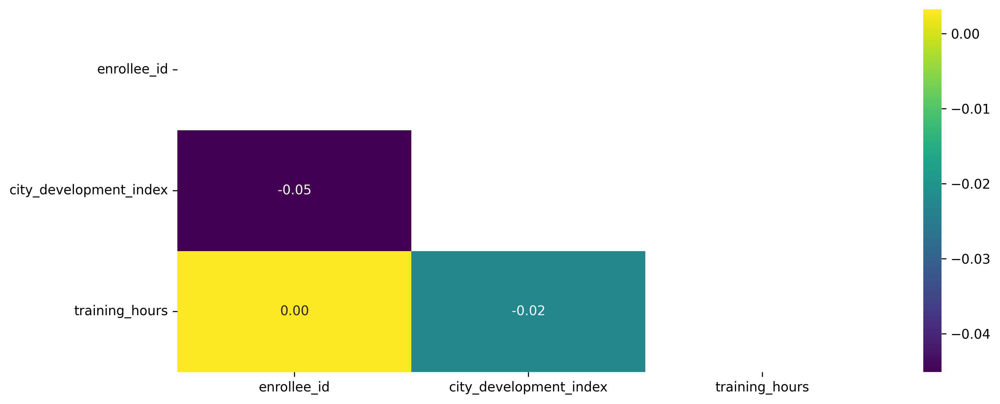

In [20]:
import numpy as np
plt.figure(figsize=(12, 5), dpi=300)
df1_corr = df1.corr()
filter = np.triu(df1_corr)
sns.heatmap(df1_corr, annot=True, cmap='viridis', mask=filter, fmt=".2f")


C:\Users\Jholman Cuartas\AppData\Local\Temp\ipykernel_10428\2060270092.py:3: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  df2_corr = df2.corr()


<AxesSubplot: >

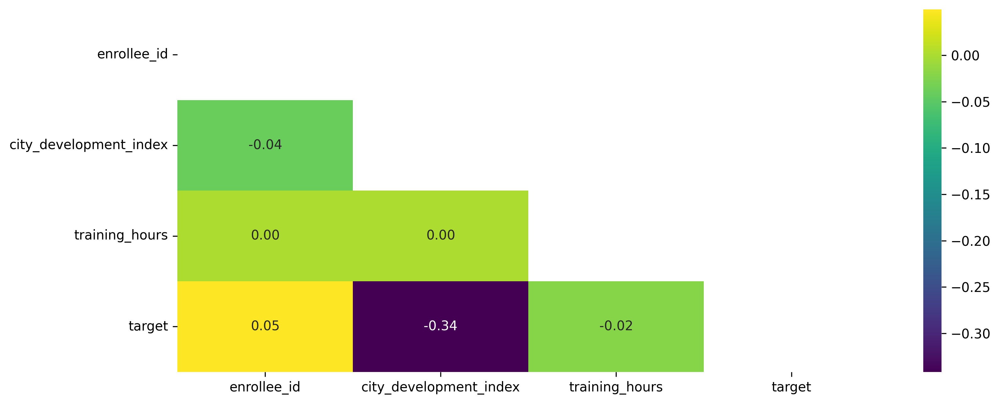

In [21]:
import numpy as np
plt.figure(figsize=(12, 5), dpi=300)
df2_corr = df2.corr()
filter = np.triu(df2_corr)
sns.heatmap(df2_corr, annot=True, cmap='viridis', mask=filter, fmt=".2f")


c:\Users\Jholman Cuartas\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\matrix.py:202: RuntimeWarning: All-NaN slice encountered
  vmin = np.nanmin(calc_data)
c:\Users\Jholman Cuartas\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\matrix.py:207: RuntimeWarning: All-NaN slice encountered
  vmax = np.nanmax(calc_data)


<AxesSubplot: >

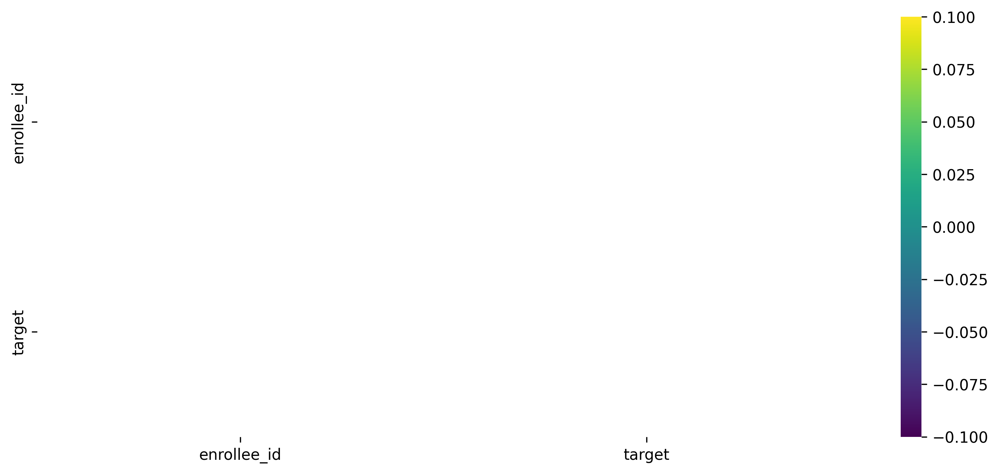

In [22]:
import numpy as np
plt.figure(figsize=(12, 5), dpi=300)
df3_corr = df3.corr()
filter = np.triu(df3_corr)
sns.heatmap(df3_corr, annot=True, cmap='viridis', mask=filter, fmt=".2f")


C:\Users\Jholman Cuartas\AppData\Local\Temp\ipykernel_10428\4017815546.py:3: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  df4_corr = df4.corr()


<AxesSubplot: >

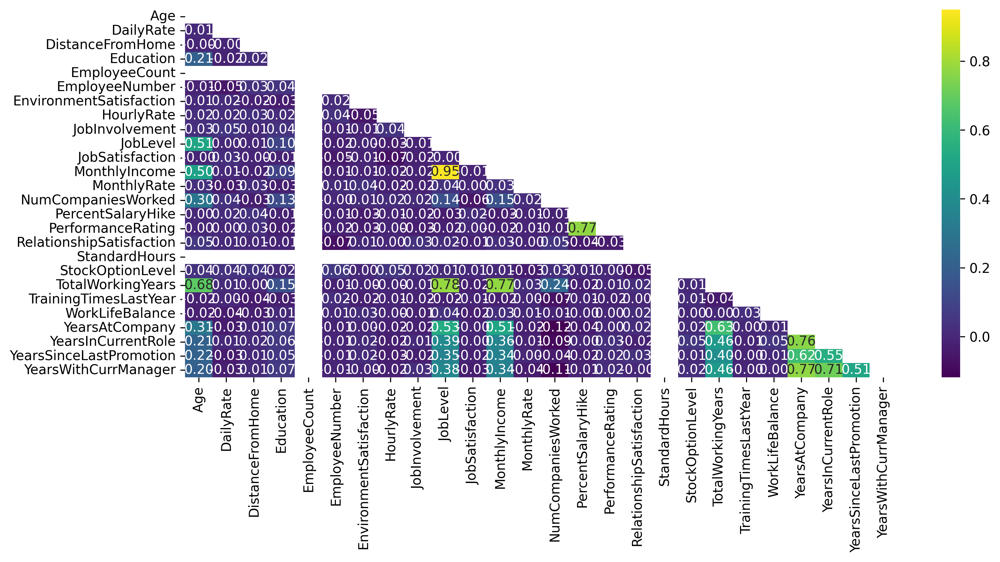

In [23]:
import numpy as np
plt.figure(figsize=(12, 5), dpi=300)
df4_corr = df4.corr()
filter = np.triu(df4_corr)
sns.heatmap(df4_corr, annot=True, cmap='viridis', mask=filter, fmt=".2f")


### Informes CSV


In [24]:
profile = ProfileReport(df1, title="Pandas Profiling Report")
profile


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [25]:
profile = ProfileReport(df2, title="Pandas Profiling Report")
profile


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [26]:
profile = ProfileReport(df3, title="Pandas Profiling Report")
profile


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [27]:
profile = ProfileReport(df4, title="Pandas Profiling Report")
profile


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

#### El código importa la librería Seaborn y luego utiliza la función pairplot para generar un gráfico de dispersión de pares para las columnas seleccionadas del DataFrame df4. Esto ayuda a visualizar las relaciones entre las variables y proporciona información sobre posibles correlaciones o patrones en los datos.


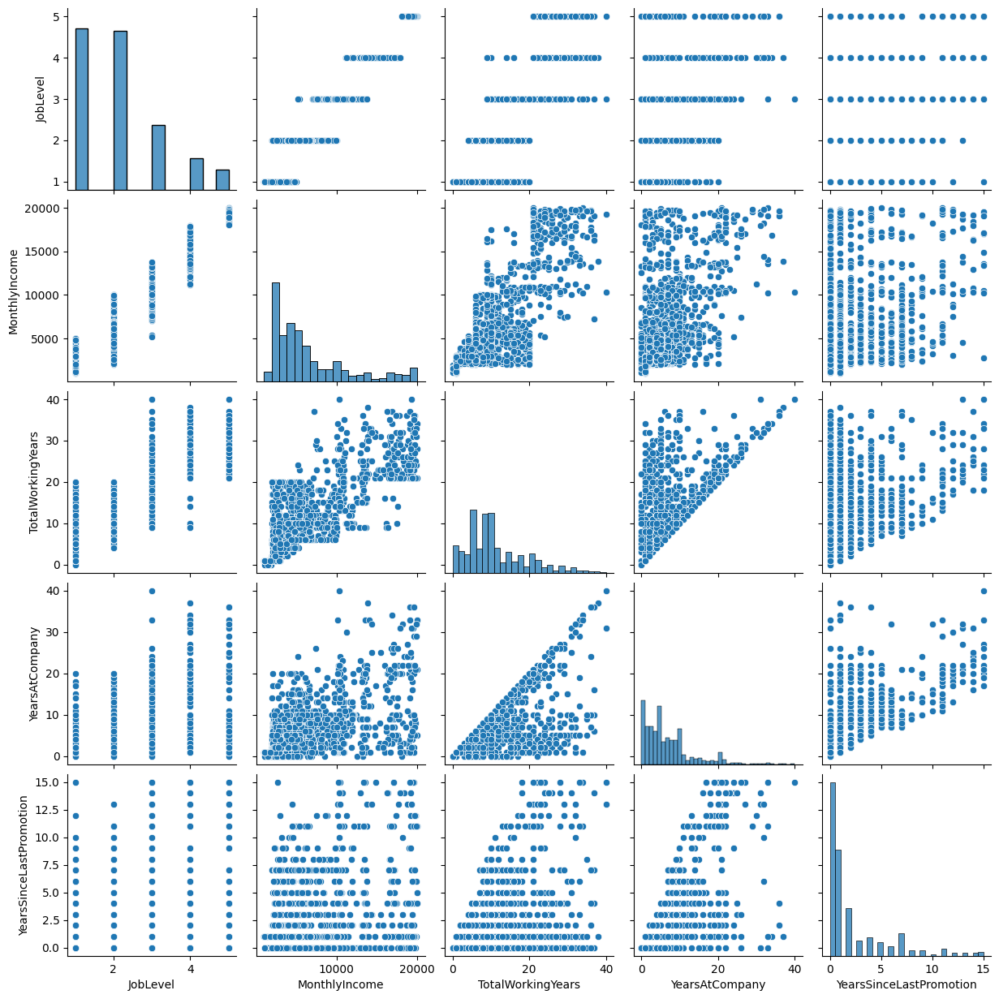

In [28]:
import seaborn as sns
sns.pairplot(df4[['JobLevel', 'MonthlyIncome', 'TotalWorkingYears',
             'YearsAtCompany', 'YearsSinceLastPromotion']])


#### Recuentos de Valores no nulos


In [29]:
print(df1.describe(include='all').loc['count'])


enrollee_id               2129.0
city                        2129
city_development_index    2129.0
gender                      1621
relevent_experience         2129
enrolled_university         2098
education_level             2077
major_discipline            1817
experience                  2124
company_size                1507
company_type                1495
last_new_job                2089
training_hours            2129.0
Name: count, dtype: object


In [30]:
print(df2.describe(include='all').loc['count'])


enrollee_id               19158.0
city                        19158
city_development_index    19158.0
gender                      14650
relevent_experience         19158
enrolled_university         18772
education_level             18698
major_discipline            16345
experience                  19093
company_size                13220
company_type                13018
last_new_job                18735
training_hours            19158.0
target                    19158.0
Name: count, dtype: object


In [31]:
print(df3.describe(include='all').loc['count'])


enrollee_id    2129.0
target         2129.0
Name: count, dtype: float64


In [32]:
print(df4.describe(include='all').loc['count'])


Age                         1470.0
Attrition                     1470
BusinessTravel                1470
DailyRate                   1470.0
Department                    1470
DistanceFromHome            1470.0
Education                   1470.0
EducationField                1470
EmployeeCount               1470.0
EmployeeNumber              1470.0
EnvironmentSatisfaction     1470.0
Gender                        1470
HourlyRate                  1470.0
JobInvolvement              1470.0
JobLevel                    1470.0
JobRole                       1470
JobSatisfaction             1470.0
MaritalStatus                 1470
MonthlyIncome               1470.0
MonthlyRate                 1470.0
NumCompaniesWorked          1470.0
Over18                        1470
OverTime                      1470
PercentSalaryHike           1470.0
PerformanceRating           1470.0
RelationshipSatisfaction    1470.0
StandardHours               1470.0
StockOptionLevel            1470.0
TotalWorkingYears   

# imputar valores nulos


#### df1


#### Columna city_development_index


In [33]:
# imputar valores nulos en city_development_index
filter = df1['city_development_index'].isnull()
print(df1[filter].index)

for i in df1[filter].index:
    # filtro por training_hours
    filter = df1['training_hours'] == df1.iloc[i]['training_hours']
  # Imputar valor medio de Nivel de empleo según valor medio ingreso mensual
mean_city_development_index = df1.groupby(
    'training_hours')['city_development_index'].mean()
for i in df1[filter].index:
    training_hours_count = df.loc[i, 'training_hours']
    df1.loc[i, 'city_development_index'] = mean_city_development_index[training_hours_count]


Int64Index([], dtype='int64')


In [34]:
# imputar valores nulos en city_development_index
filter = df1['city_development_index'].isnull()
print(df1[filter].index)

for i in df1[filter].index:
    # filtro por enrollee_id
    filter = df1['enrollee_id'] == df1.iloc[i]['enrollee_id']
  # Imputar valor medio de Nivel de empleo según valor medio ingreso mensual
mean_city_development_index = df1.groupby(
    'enrollee_id')['city_development_index'].mean()
for i in df1[filter].index:
    enrollee_id_count = df.loc[i, 'enrollee_id']
    df1.loc[i, 'city_development_index'] = mean_city_development_index[enrollee_id_count]


Int64Index([], dtype='int64')


In [35]:
# imputar valores nulos en JobLevel
filter = df4['JobLevel'].isnull()
print(df4[filter].index)

for i in df4[filter].index:
    # filtro por Age
    filter = df4['Age'] == df4.iloc[i]['Age']
  # Imputar valor medio de Nivel de empleo según valor medio ingreso mensual
mean_JobLevel = df4.groupby('Age')['JobLevel'].mean()
for i in df4[filter].index:
    Age_count = df.loc[i, 'Age']
    df4.loc[i, 'JobLevel'] = mean_JobLevel[Age_count]


Int64Index([], dtype='int64')


#### df 4


### Columna JobLevel


In [36]:
# imputar valores nulos en JobLevel
filter = df4['JobLevel'].isnull()
print(df4[filter].index)

for i in df4[filter].index:
    # filtro por Age
    filter = df4['Age'] == df4.iloc[i]['Age']
  # Imputar valor medio de Nivel de empleo según valor medio ingreso mensual
mean_JobLevel = df4.groupby('Age')['JobLevel'].mean()
for i in df4[filter].index:
    Age_count = df.loc[i, 'Age']
    df4.loc[i, 'JobLevel'] = mean_JobLevel[Age_count]


Int64Index([], dtype='int64')


In [37]:
# imputar valores nulos en JobLevel
filter = df4['JobLevel'].isnull()
print(df4[filter].index)

for i in df4[filter].index:
    # filtro por MonthlyIncome
    filter = df4['MonthlyIncome'] == df4.iloc[i]['MonthlyIncome']
  # Imputar valor medio de Nivel de empleo según valor medio ingreso mensual
mean_JobLevel = df4.groupby('MonthlyIncome')['JobLevel'].mean()
for i in df4[filter].index:
    MonthlyIncome_count = df.loc[i, 'MonthlyIncome']
    df4.loc[i, 'JobLevel'] = mean_JobLevel[MonthlyIncome_count]


Int64Index([], dtype='int64')


In [38]:
# imputar valores nulos en JobLevel
filter = df4['JobLevel'].isnull()
print(df4[filter].index)

for i in df4[filter].index:
    # filtro por TotalWorkingYears
    filter = df4['TotalWorkingYears'] == df4.iloc[i]['TotalWorkingYears']
  # Imputar valor medio de Nivel de empleo según total de años trabajados
mean_JobLevel = df4.groupby('TotalWorkingYears')['JobLevel'].mean()
for i in df4[filter].index:
    TotalWorkingYears_count = df.loc[i, 'TotalWorkingYears']
    df4.loc[i, 'JobLevel'] = mean_JobLevel[TotalWorkingYears_count]


Int64Index([], dtype='int64')


In [39]:
# imputar valores nulos en JobLevel
filter = df4['JobLevel'].isnull()
print(df4[filter].index)

for i in df4[filter].index:
    # filtro por YearsAtCompany
    filter = df4['YearsAtCompany'] == df4.iloc[i]['YearsAtCompany']
  # Imputar valor medio de Nivel de empleo según número de Años en la Compañía
mean_JobLevel = df4.groupby('YearsAtCompany')['JobLevel'].mean()
for i in df4[filter].index:
    YearsAtCompany_count = df.loc[i, 'YearsAtCompany']
    df4.loc[i, 'JobLevel'] = mean_JobLevel[YearsAtCompany_count]


Int64Index([], dtype='int64')


In [40]:
# imputar valores nulos en JobLevel
filter = df4['JobLevel'].isnull()
print(df4[filter].index)

for i in df4[filter].index:
    # filtro por YearsInCurrentRole
    filter = df4['YearsInCurrentRole'] == df4.iloc[i]['YearsInCurrentRole']
  # Imputar valor medio de Nivel de empleo según número de Años en Cargo Actual
mean_JobLevel = df4.groupby('YearsInCurrentRole')['JobLevel'].mean()
for i in df4[filter].index:
    YearsInCurrentRole_count = df.loc[i, 'YearsInCurrentRole']
    df4.loc[i, 'JobLevel'] = mean_JobLevel[YearsInCurrentRole_count]


Int64Index([], dtype='int64')


In [41]:
# imputar valores nulos en JobLevel
filter = df4['JobLevel'].isnull()
print(df4[filter].index)

for i in df4[filter].index:
    # filtro por YearsSinceLastPromotion
    filter = df4['YearsSinceLastPromotion'] == df4.iloc[i]['YearsSinceLastPromotion']
  # Imputar valor medio de Nivel de empleo según número de Años desde la ultima promoción
mean_JobLevel = df4.groupby('YearsSinceLastPromotion')['JobLevel'].mean()
for i in df4[filter].index:
    YearsSinceLastPromotion_count = df.loc[i, 'YearsSinceLastPromotion']
    df4.loc[i, 'JobLevel'] = mean_JobLevel[YearsSinceLastPromotion_count]


Int64Index([], dtype='int64')


In [42]:
# imputar valores nulos en JobLevel
filter = df4['JobLevel'].isnull()
print(df4[filter].index)

for i in df4[filter].index:
    # filtro por YearsWithCurrManager
    filter = df4['YearsWithCurrManager'] == df4.iloc[i]['YearsWithCurrManager']
  # Imputar valor medio de Nivel de empleo según número de Años con el jefe actual
mean_JobLevel = df4.groupby('YearsWithCurrManager')['JobLevel'].mean()
for i in df4[filter].index:
    YearsWithCurrManager_count = df.loc[i, 'YearsWithCurrManager']
    df4.loc[i, 'JobLevel'] = mean_JobLevel[YearsWithCurrManager_count]


Int64Index([], dtype='int64')


### Columna JobSatisfaction


In [43]:
# imputar valores nulos en JobSatisfaction
filter = df4['JobSatisfaction'].isnull()
print(df4[filter].index)

for i in df4[filter].index:
    # filtro por TotalWorkingYears
    filter = df4['TotalWorkingYears'] == df4.iloc[i]['TotalWorkingYears']
  # Imputar valor medio de Satisfacción laboral según total de años trabajados
mean_JobSatisfaction = df4.groupby('TotalWorkingYears')[
    'JobSatisfaction'].mean()
for i in df4[filter].index:
    TotalWorkingYears_count = df.loc[i, 'TotalWorkingYears']
    df4.loc[i, 'JobSatisfaction'] = mean_JobSatisfaction[TotalWorkingYears_count]


Int64Index([], dtype='int64')


In [44]:
# imputar valores nulos en JobSatisfaction
filter = df4['JobSatisfaction'].isnull()
print(df4[filter].index)

for i in df4[filter].index:
    # filtro por YearsAtCompany
    filter = df4['YearsAtCompany'] == df4.iloc[i]['YearsAtCompany']
  # Imputar valor medio de Satisfacción laboral según número de Años en la Compañía
mean_JobSatisfaction = df4.groupby('YearsAtCompany')['JobSatisfaction'].mean()
for i in df4[filter].index:
    YearsAtCompany_count = df.loc[i, 'YearsAtCompany']
    df4.loc[i, 'JobSatisfactionl'] = mean_JobLevel[YearsAtCompany_count]


Int64Index([], dtype='int64')


In [45]:
# imputar valores nulos en JobSatisfaction
filter = df4['JobSatisfaction'].isnull()
print(df4[filter].index)

for i in df4[filter].index:
    # filtro por YearsInCurrentRole
    filter = df4['YearsInCurrentRole'] == df4.iloc[i]['YearsInCurrentRole']
  # Imputar valor medio de Satisfacción laboral según número de Años en Cargo Actual
mean_JobSatisfaction = df4.groupby('YearsInCurrentRole')[
    'JobSatisfaction'].mean()
for i in df4[filter].index:
    YearsInCurrentRole_count = df.loc[i, 'YearsInCurrentRole']
    df4.loc[i, 'JobSatisfaction'] = mean_JobSatisfaction[YearsInCurrentRole_count]


Int64Index([], dtype='int64')


In [46]:
# imputar valores nulos en JobSatisfaction
filter = df4['JobSatisfaction'].isnull()
print(df4[filter].index)

for i in df4[filter].index:
    # filtro por YearsSinceLastPromotion
    filter = df4['YearsSinceLastPromotion'] == df4.iloc[i]['YearsSinceLastPromotion']
  # Imputar valor medio de Satisfacción laboral según número de Años desde la ultima promoción
mean_JobSatisfaction = df4.groupby('YearsSinceLastPromotion')[
    'JobSatisfaction'].mean()
for i in df4[filter].index:
    YearsSinceLastPromotion_count = df.loc[i, 'YearsSinceLastPromotion']
    df4.loc[i, 'JobSatisfaction'] = mean_JobSatisfaction[YearsSinceLastPromotion_count]


Int64Index([], dtype='int64')


In [47]:
# imputar valores nulos en JobSatisfaction
filter = df4['JobSatisfaction'].isnull()
print(df4[filter].index)

for i in df4[filter].index:
    # filtro por YearsWithCurrManager
    filter = df4['YearsWithCurrManager'] == df4.iloc[i]['YearsWithCurrManager']
  # Imputar valor medio Satisfacción laboral según número de Años con el jefe actual
mean_JobSatisfaction = df4.groupby('YearsWithCurrManager')[
    'JobSatisfaction'].mean()
for i in df4[filter].index:
    YearsWithCurrManager_count = df.loc[i, 'YearsWithCurrManager']
    df4.loc[i, 'JobSatisfaction'] = mean_JobSatisfaction[YearsWithCurrManager_count]


Int64Index([], dtype='int64')


### Columna MonthlyInCome


In [48]:
# imputar valores nulos en MonthlyIncome
filter = df4['MonthlyIncome'].isnull()
print(df4[filter].index)

for i in df4[filter].index:
    # filtro por JobLevel
    filter = df4['JobLevel'] == df4.iloc[i]['JobLevel']
  # Imputar valor medio de Ingresos mensuales según la Edad
mean_MonthlyIncome = df4.groupby('JobLevel')['MonthlyIncome'].mean()
for i in df4[filter].index:
    JobLevel_count = df.loc[i, 'JobLevel']
    df4.loc[i, 'MonthlyIncome'] = mean_MonthlyIncome[JobLevel_count]


Int64Index([], dtype='int64')


In [49]:
# imputar valores nulos en MonthlyIncome
filter = df4['MonthlyIncome'].isnull()
print(df4[filter].index)

for i in df4[filter].index:
    # filtro por Age
    filter = df4['Age'] == df4.iloc[i]['Age']
  # Imputar valor medio de Ingresos mensuales según la Edad
mean_MonthlyIncome = df4.groupby('Age')['MonthlyIncome'].mean()
for i in df4[filter].index:
    Age_count = df.loc[i, 'Age']
    df4.loc[i, 'MonthlyIncome'] = mean_MonthlyIncome[Age_count]


Int64Index([], dtype='int64')


In [50]:
# imputar valores nulos en MonthlyIncome
filter = df4['MonthlyIncome'].isnull()
print(df4[filter].index)

for i in df4[filter].index:
    # filtro por TotalWorkingYears
    filter = df4['TotalWorkingYears'] == df4.iloc[i]['TotalWorkingYears']
  # Imputar valor medio de Ingresos mensuales según la Edad
mean_MonthlyIncome = df4.groupby('TotalWorkingYears')['MonthlyIncome'].mean()
for i in df4[filter].index:
    TotalWorkingYears_count = df.loc[i, 'TotalWorkingYears']
    df4.loc[i, 'MonthlyIncome'] = mean_MonthlyIncome[TotalWorkingYears_count]


Int64Index([], dtype='int64')


In [51]:
# imputar valores nulos en MonthlyIncome
filter = df4['MonthlyIncome'].isnull()
print(df4[filter].index)

for i in df4[filter].index:
    # filtro por YearsAtCompany
    filter = df4['YearsAtCompany'] == df4.iloc[i]['YearsAtCompany']
  # Imputar valor medio de Ingresos mensuales según la Edad
mean_MonthlyIncome = df4.groupby('YearsAtCompany')['MonthlyIncome'].mean()
for i in df4[filter].index:
    YearsAtCompany_count = df.loc[i, 'YearsAtCompany']
    df4.loc[i, 'MonthlyIncome'] = mean_MonthlyIncome[YearsAtCompany_count]


Int64Index([], dtype='int64')


In [52]:
# imputar valores nulos en MonthlyIncome
filter = df4['MonthlyIncome'].isnull()
print(df4[filter].index)

for i in df4[filter].index:
    # filtro por YearsInCurrentRole
    filter = df4['YearsInCurrentRole'] == df4.iloc[i]['YearsInCurrentRole']
  # Imputar valor medio de Ingresos mensuales según la Edad
mean_MonthlyIncome = df4.groupby('YearsInCurrentRole')['MonthlyIncome'].mean()
for i in df4[filter].index:
    YearsInCurrentRole_count = df.loc[i, 'YearsInCurrentRole']
    df4.loc[i, 'MonthlyIncome'] = mean_MonthlyIncome[YearsInCurrentRole_count]


Int64Index([], dtype='int64')


In [53]:
# imputar valores nulos en MonthlyIncome
filter = df4['MonthlyIncome'].isnull()
print(df4[filter].index)

for i in df4[filter].index:
    # filtro por YearsSinceLastPromotion
    filter = df4['YearsSinceLastPromotion'] == df4.iloc[i]['YearsSinceLastPromotion']
  # Imputar valor medio de Ingresos mensuales según la Edad
mean_MonthlyIncome = df4.groupby('YearsSinceLastPromotion')[
    'MonthlyIncome'].mean()
for i in df4[filter].index:
    YearsSinceLastPromotion_count = df.loc[i, 'YearsSinceLastPromotion']
    df4.loc[i, 'MonthlyIncome'] = mean_MonthlyIncome[YearsSinceLastPromotion_count]


Int64Index([], dtype='int64')


In [54]:
# imputar valores nulos en MonthlyIncome
filter = df4['MonthlyIncome'].isnull()
print(df4[filter].index)

for i in df4[filter].index:
    # filtro por YearsWithCurrManager
    filter = df4['YearsWithCurrManager'] == df4.iloc[i]['YearsWithCurrManager']
  # Imputar valor medio de Ingresos mensuales según la Edad
mean_MonthlyIncome = df4.groupby('YearsWithCurrManager')[
    'MonthlyIncome'].mean()
for i in df4[filter].index:
    YearsWithCurrManager_count = df.loc[i, 'YearsWithCurrManager']
    df4.loc[i, 'MonthlyIncome'] = mean_MonthlyIncome[YearsWithCurrManager_count]


Int64Index([], dtype='int64')


### Columna PercentSalaryHike


In [55]:
# imputar valores nulos en PercentSalaryHike
filter = df4['PercentSalaryHike'].isnull()
print(df4[filter].index)

for i in df4[filter].index:
    # filtro por PerformanceRating
    filter = df4['PerformanceRating'] == df4.iloc[i]['PerformanceRating']
  # Imputar valor medio de Porcentaje de aumento salarial según valoración del rendimiento
mean_PercentSalaryHike = df4.groupby('PerformanceRating')[
    'PercentSalaryHike'].mean()
for i in df4[filter].index:
    PerformanceRating_count = df.loc[i, 'PerformanceRating']
    df4.loc[i, 'PercentSalaryHike'] = mean_PercentSalaryHike[PerformanceRating_count]


Int64Index([], dtype='int64')


### Columna TotalWorkingYears


In [56]:
# imputar valores nulos en TotalWorkingYears
filter = df4['TotalWorkingYears'].isnull()
print(df4[filter].index)

for i in df4[filter].index:
    # filtro por YearsAtCompany
    filter = df4['YearsAtCompany'] == df4.iloc[i]['YearsAtCompany']
  # Imputar valor medio de Total años trabajadod según número años en la compañía
mean_TotalWorkingYears = df4.groupby('YearsAtCompany')[
    'TotalWorkingYears'].mean()
for i in df4[filter].index:
    YearsAtCompany_count = df.loc[i, 'YearsAtCompany']
    df4.loc[i, 'TotalWorkingYears'] = mean_TotalWorkingYears[YearsAtCompany_count]


Int64Index([], dtype='int64')


In [57]:
# imputar valores nulos en TotalWorkingYears
filter = df4['TotalWorkingYears'].isnull()
print(df4[filter].index)

for i in df4[filter].index:
    # filtro por YearsInCurrentRole
    filter = df4['YearsInCurrentRole'] == df4.iloc[i]['YearsInCurrentRole']
  # Imputar valor medio de Total de años trabajados según número de años en el cargo actual
mean_TotalWorkingYears = df4.groupby('YearsInCurrentRole')[
    'TotalWorkingYears'].mean()
for i in df4[filter].index:
    YearsInCurrentRole_count = df.loc[i, 'YearsInCurrentRole']
    df4.loc[i, 'TotalWorkingYears'] = mean_TotalWorkingYears[YearsInCurrentRole_count]


Int64Index([], dtype='int64')


In [58]:
# imputar valores nulos en TotalWorkingYears
filter = df4['TotalWorkingYears'].isnull()
print(df4[filter].index)

for i in df4[filter].index:
    # filtro por YearsWithCurrManager
    filter = df4['YearsWithCurrManager'] == df4.iloc[i]['YearsWithCurrManager']
  # Imputar valor medio de Total Años jtrabajados según número de años con el actual gerente
mean_TotalWorkingYears = df4.groupby('YearsWithCurrManager')[
    'TotalWorkingYears'].mean()
for i in df4[filter].index:
    YearsAtCompany_count = df.loc[i, 'YearsWithCurrManager']
    df4.loc[i, 'TotalWorkingYears'] = mean_YearsAtCompany[YearsWithCurrManager_count]


Int64Index([], dtype='int64')


In [59]:
# imputar valores nulos en TotalWorkingYears
filter = df4['TotalWorkingYears'].isnull()
print(df4[filter].index)

for i in df4[filter].index:
    # filtro por Age
    filter = df4['Age'] == df4.iloc[i]['Age']
  # Imputar valor medio de Total años trabajadod según número años en la compañía
mean_TotalWorkingYears = df4.groupby('Age')['TotalWorkingYears'].mean()
for i in df4[filter].index:
    Age_count = df.loc[i, 'YearsAtCompany']
    df4.loc[i, 'TotalWorkingYears'] = mean_TotalWorkingYears[Age_count]


Int64Index([], dtype='int64')


In [60]:
# imputar valores nulos en TotalWorkingYears
filter = df4['TotalWorkingYears'].isnull()
print(df4[filter].index)

for i in df4[filter].index:
    # filtro por JobLevel
    filter = df4['JobLevel'] == df4.iloc[i]['JobLevel']
  # Imputar valor medio de Total años trabajadod según número años en la compañía
mean_TotalWorkingYears = df4.groupby('JobLevel')['TotalWorkingYears'].mean()
for i in df4[filter].index:
    JobLevel_count = df.loc[i, 'JobLevel']
    df4.loc[i, 'TotalWorkingYears'] = mean_TotalWorkingYears[JobLevel_count]


Int64Index([], dtype='int64')


In [61]:

# # imputar valores nulos en TotalWorkingYears
# filter = df4['TotalWorkingYears'].isnull()
# print(df4[filter].index)

# for i in df4[filter].index:
#     # filtro por MonthlyInCome
#     filter = df4['MonthlyInCome'] == df4.iloc[i]['MonthlyInCome']
#   # Imputar valor medio de Total años trabajadod según número años en la compañía
# mean_TotalWorkingYears = df4.groupby('MonthlyInCome')['TotalWorkingYears'].mean()
# for i in df4[filter].index:
#     MonthlyInCome_count = df.loc[i, 'MonthlyInCome']
#     df4.loc[i, 'TotalWorkingYears'] = mean_TotalWorkingYears[MonthlyInCome_count]


# El mensaje de error sugiere que no hay ninguna columna llamada 'MonthlyInCome' en el DataFrame,
# lo que está causando un KeyError al intentar agrupar por esa columna. Podría tratarse de un error
# tipográfico en el nombre de la columna o de algún otro problema con el DataFrame. También es posible
# que el DataFrame esté vacío, lo que podría explicar por qué no hay valores en el Int64Index.


### Columna YearsAtCompany


In [62]:
# imputar valores nulos en YearsAtCompany
filter = df4['YearsAtCompany'].isnull()
print(df4[filter].index)

for i in df4[filter].index:
    # filtro por Age
    filter = df4['Age'] == df4.iloc[i]['Age']
  # Imputar valor medio de Edad según número Total Años Trabajados
mean_YearsAtCompany = df4.groupby('Age')['Age'].mean()
for i in df4[filter].index:
    YearsAtCompany_count = df.loc[i, 'Age']
    df4.loc[i, 'YearsAtCompany'] = mean_TotalWorkingYears[Age_count]


Int64Index([], dtype='int64')


In [63]:
# imputar valores nulos en YearsAtCompany
filter = df4['YearsAtCompany'].isnull()
print(df4[filter].index)

for i in df4[filter].index:
    # filtro por YearsInCurrentRole
    filter = df4['YearsInCurrentRole'] == df4.iloc[i]['YearsInCurrentRole']
  # Imputar valor medio de Edad según número Total Años Trabajados
mean_YearsAtCompany = df4.groupby('YearsInCurrentRole')[
    'YearsAtCompany'].mean()
for i in df4[filter].index:
    YearsInCurrentRole_count = df.loc[i, 'YearsInCurrentRole']
    df4.loc[i, 'YearsAtCompany'] = mean_YearsAtCompany[YearsInCurrentRole_count]


Int64Index([], dtype='int64')


In [64]:
# imputar valores nulos en YearsAtCompany
filter = df4['YearsAtCompany'].isnull()
print(df4[filter].index)

for i in df4[filter].index:
    # filtro por YearsWithCurrManager
    filter = df4['YearsWithCurrManager'] == df4.iloc[i]['YearsWithCurrManager']
  # Imputar valor medio de Edad según número Total Años Trabajados
mean_YearsAtCompany = df4.groupby('YearsWithCurrManager')[
    'YearsAtCompany'].mean()
for i in df4[filter].index:
    YearsWithCurrManager_count = df.loc[i, 'YearsWithCurrManager']
    df4.loc[i, 'YearsAtCompany'] = mean_YearsAtCompany[YearsWithCurrManager_count]


Int64Index([], dtype='int64')


### Columna Age


In [65]:
# imputar valores nulos en Age
filter = df4['Age'].isnull()
print(df4[filter].index)

for i in df4[filter].index:
    # filtro por TotalWorkingYears
    filter = df4['TotalWorkingYears'] == df4.iloc[i]['TotalWorkingYears']
  # Imputar valor medio de Edad según número Total Años Trabajados
mean_Age = df4.groupby('TotalWorkingYears')['Age'].mean()
for i in df4[filter].index:
    TotalWorkingYears_count = df.loc[i, 'TotalWorkingYear']
    df4.loc[i, 'Age'] = mean_Age[TotalWorkingYear_count]


Int64Index([], dtype='int64')


In [66]:
# imputar valores nulos en JobLevel
filter = df4['JobLevel'].isnull()
print(df4[filter].index)

for i in df4[filter].index:
    # filtro por Age
    filter = df4['Age'] == df4.iloc[i]['Age']
  # Imputar valor medio de Nivel de empleo según la Edad
mean_JobLevel = df4.groupby('Age')['JobLevel'].mean()
for i in df4[filter].index:
    Age_count = df.loc[i, 'Age']
    df4.loc[i, 'JobLevel'] = mean_JobLevel[Age_count]


Int64Index([], dtype='int64')


In [67]:
# imputar valores nulos en Age
filter = df4['Age'].isnull()
print(df4[filter].index)

for i in df4[filter].index:
    # filtro por Education
    filter = df4['Education'] == df4.iloc[i]['Education']
  # Imputar valor medio de Edad según educaión
mean_Age = df4.groupby('Education')['Age'].mean()
for i in df4[filter].index:
    Education_count = df.loc[i, 'Education']
    df4.loc[i, 'Age'] = mean_Age[Education_count]


Int64Index([], dtype='int64')


In [68]:
# imputar valores nulos en Age
filter = df4['Age'].isnull()
print(df4[filter].index)

for i in df4[filter].index:
    # filtro por NumCompaniesWorked
    filter = df4['NumCompaniesWorked'] == df4.iloc[i]['NumCompaniesWorked']
  # Imputar valor medio de Edad según número de Empresas trabajadas
mean_Age = df4.groupby('NumCompaniesWorked')['Age'].mean()
for i in df4[filter].index:
    NumCompaniesWorked_count = df.loc[i, 'NumCompaniesWorked']
    df4.loc[i, 'Age'] = mean_Age[NumCompaniesWorked_count]


Int64Index([], dtype='int64')


In [69]:
# imputar valores nulos en Age
filter = df4['Age'].isnull()
print(df4[filter].index)

for i in df4[filter].index:
    # filtro por YearsAtCompany
    filter = df4['YearsAtCompany'] == df4.iloc[i]['YearsAtCompany']
  # Imputar valor medio de Edad según número de Años en la Empresa
mean_Age = df4.groupby('YearsAtCompany')['Age'].mean()
for i in df4[filter].index:
    YearsAtCompany_count = df.loc[i, 'YearsAtCompany']
    df4.loc[i, 'Age'] = mean_Age[YearsAtCompany_count]


Int64Index([], dtype='int64')


In [70]:
# imputar valores nulos en Age
filter = df4['Age'].isnull()
print(df4[filter].index)

for i in df4[filter].index:
    # filtro por YearsInCurrentRole
    filter = df4['YearsInCurrentRole'] == df4.iloc[i]['YearsInCurrentRole']
  # Imputar valor medio de Edad según número de Años en el Cargo Actual
mean_Age = df4.groupby('YearsInCurrentRole')['Age'].mean()
for i in df4[filter].index:
    YearsInCurrentRole_count = df.loc[i, 'YearsInCurrentRole']
    df4.loc[i, 'Age'] = mean_Age[YearsInCurrentRole_count]


Int64Index([], dtype='int64')


In [71]:
# imputar valores nulos en Age
filter = df4['Age'].isnull()
print(df4[filter].index)

for i in df4[filter].index:
    # filtro por YearsSinceLastPromotion
    filter = df4['YearsSinceLastPromotion'] == df4.iloc[i]['YearsSinceLastPromotion']
  # Imputar valor medio de Edad según número de Años desde la última promoción
mean_Age = df4.groupby('YearsSinceLastPromotion')['Age'].mean()
for i in df4[filter].index:
    YearsSinceLastPromotion_count = df.loc[i, 'YearsSinceLastPromotion']
    df4.loc[i, 'Age'] = mean_Age[YearsSinceLastPromotion_count]


Int64Index([], dtype='int64')


In [72]:
# imputar valores nulos en Age
filter = df4['Age'].isnull()
print(df4[filter].index)

for i in df4[filter].index:
    # filtro por MonthlyIncome
    filter = df4['MonthlyIncome'] == df4.iloc[i]['MonthlyIncome']
  # Imputar valor medio de Edad según número medio de ingresos mensuales
mean_Age = df4.groupby('MonthlyIncome')['Age'].mean()
for i in df4[filter].index:
    MonthlyIncome_count = df.loc[i, 'MonthlyIncome']
    df4.loc[i, 'Age'] = mean_Age[MonthlyIncome_count]


Int64Index([], dtype='int64')


### Calcular Porcentaje de nulos en cada Columna


In [73]:
from data_util import calc_missing
# el archivo data_util.py tiene que estar en el mismo directorio
calc_missing(df1)


gender 508 / 2129 23.86 %
enrolled_university 31 / 2129 1.46 %
education_level 52 / 2129 2.44 %
major_discipline 312 / 2129 14.65 %
experience 5 / 2129 0.23 %
company_size 622 / 2129 29.22 %
company_type 634 / 2129 29.78 %
last_new_job 40 / 2129 1.88 %


In [74]:
from data_util import calc_missing
# el archivo data_util.py tiene que estar en el mismo directorio
calc_missing(df2)


gender 4508 / 19158 23.53 %
enrolled_university 386 / 19158 2.01 %
education_level 460 / 19158 2.40 %
major_discipline 2813 / 19158 14.68 %
experience 65 / 19158 0.34 %
company_size 5938 / 19158 30.99 %
company_type 6140 / 19158 32.05 %
last_new_job 423 / 19158 2.21 %


In [75]:
from data_util import calc_missing
# el archivo data_util.py tiene que estar en el mismo directorio
calc_missing(df3)


In [76]:
from data_util import calc_missing
# el archivo data_util.py tiene que estar en el mismo directorio
calc_missing(df4)


In [77]:
df1.head(1)


,enrollee_id,city,city_development_index,gender,relevent_experience,enrolled_university,education_level,major_discipline,experience,company_size,company_type,last_new_job,training_hours
0,32403,city_41,0.827,Male,Has relevent experience,Full time course,Graduate,STEM,9,<10,NaN,1,21


In [78]:
df2.head(1)


,enrollee_id,city,city_development_index,gender,relevent_experience,enrolled_university,education_level,major_discipline,experience,company_size,company_type,last_new_job,training_hours,target
0,8949,city_103,0.92,Male,Has relevent experience,no_enrollment,Graduate,STEM,>20,NaN,NaN,1,36,1.0


In [79]:
df3.head(1)


,enrollee_id,target
0,32403,0.5


In [80]:
df4.head(1)


,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,...,1,80,0,8,0,1,6,4,0,5


In [81]:
df1.isnull().sum()


enrollee_id                 0
city                        0
city_development_index      0
gender                    508
relevent_experience         0
enrolled_university        31
education_level            52
major_discipline          312
experience                  5
company_size              622
company_type              634
last_new_job               40
training_hours              0
dtype: int64

In [82]:
df2.isnull().sum()


enrollee_id                  0
city                         0
city_development_index       0
gender                    4508
relevent_experience          0
enrolled_university        386
education_level            460
major_discipline          2813
experience                  65
company_size              5938
company_type              6140
last_new_job               423
training_hours               0
target                       0
dtype: int64

In [83]:
df3.isnull().sum()


enrollee_id    0
target         0
dtype: int64

In [84]:
df4.isnull().sum()


Age                         0
Attrition                   0
BusinessTravel              0
DailyRate                   0
Department                  0
DistanceFromHome            0
Education                   0
EducationField              0
EmployeeCount               0
EmployeeNumber              0
EnvironmentSatisfaction     0
Gender                      0
HourlyRate                  0
JobInvolvement              0
JobLevel                    0
JobRole                     0
JobSatisfaction             0
MaritalStatus               0
MonthlyIncome               0
MonthlyRate                 0
NumCompaniesWorked          0
Over18                      0
OverTime                    0
PercentSalaryHike           0
PerformanceRating           0
RelationshipSatisfaction    0
StandardHours               0
StockOptionLevel            0
TotalWorkingYears           0
TrainingTimesLastYear       0
WorkLifeBalance             0
YearsAtCompany              0
YearsInCurrentRole          0
YearsSince

In [85]:
print(df4.describe(include='all').loc['count'])


Age                         1470.0
Attrition                     1470
BusinessTravel                1470
DailyRate                   1470.0
Department                    1470
DistanceFromHome            1470.0
Education                   1470.0
EducationField                1470
EmployeeCount               1470.0
EmployeeNumber              1470.0
EnvironmentSatisfaction     1470.0
Gender                        1470
HourlyRate                  1470.0
JobInvolvement              1470.0
JobLevel                    1470.0
JobRole                       1470
JobSatisfaction             1470.0
MaritalStatus                 1470
MonthlyIncome               1470.0
MonthlyRate                 1470.0
NumCompaniesWorked          1470.0
Over18                        1470
OverTime                      1470
PercentSalaryHike           1470.0
PerformanceRating           1470.0
RelationshipSatisfaction    1470.0
StandardHours               1470.0
StockOptionLevel            1470.0
TotalWorkingYears   

### Información básica

#### semana del 12 de junio


In [86]:
df4 = pd.read_csv(
    r'C:\Users\Jholman Cuartas\Desktop\proyecto grupo 3\HR-Employee-Attrition.csv')


In [87]:
df4.shape


(1470, 35)

In [88]:
df4.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1470 entries, 0 to 1469
Data columns (total 35 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   Age                       1470 non-null   int64 
 1   Attrition                 1470 non-null   object
 2   BusinessTravel            1470 non-null   object
 3   DailyRate                 1470 non-null   int64 
 4   Department                1470 non-null   object
 5   DistanceFromHome          1470 non-null   int64 
 6   Education                 1470 non-null   int64 
 7   EducationField            1470 non-null   object
 8   EmployeeCount             1470 non-null   int64 
 9   EmployeeNumber            1470 non-null   int64 
 10  EnvironmentSatisfaction   1470 non-null   int64 
 11  Gender                    1470 non-null   object
 12  HourlyRate                1470 non-null   int64 
 13  JobInvolvement            1470 non-null   int64 
 14  JobLevel                

In [89]:
pd.set_option('display.max_columns', None)
df4 = pd.read_csv(
    r'C:\Users\Jholman Cuartas\Desktop\proyecto grupo 3\HR-Employee-Attrition.csv')
df4.head(1)


,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,JobLevel,JobRole,JobSatisfaction,MaritalStatus,MonthlyIncome,MonthlyRate,NumCompaniesWorked,Over18,OverTime,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,2,Female,94,3,2,Sales Executive,4,Single,5993,19479,8,Y,Yes,11,3,1,80,0,8,0,1,6,4,0,5


In [90]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', 1400)
df4 = pd.read_csv(
    r'C:\Users\Jholman Cuartas\Desktop\proyecto grupo 3\HR-Employee-Attrition.csv')
df4.head(1)


,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,JobLevel,JobRole,JobSatisfaction,MaritalStatus,MonthlyIncome,MonthlyRate,NumCompaniesWorked,Over18,OverTime,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,2,Female,94,3,2,Sales Executive,4,Single,5993,19479,8,Y,Yes,11,3,1,80,0,8,0,1,6,4,0,5


In [91]:
df4.describe(include='all')


,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,JobLevel,JobRole,JobSatisfaction,MaritalStatus,MonthlyIncome,MonthlyRate,NumCompaniesWorked,Over18,OverTime,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
count,1470.000000,1470,1470,1470.000000,1470,1470.000000,1470.000000,1470,1470.0,1470.000000,1470.000000,1470,1470.000000,1470.000000,1470.000000,1470,1470.000000,1470,1470.000000,1470.000000,1470.000000,1470,1470,1470.000000,1470.000000,1470.000000,1470.0,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000
unique,NaN,2,3,NaN,3,NaN,NaN,6,NaN,NaN,NaN,2,NaN,NaN,NaN,9,NaN,3,NaN,NaN,NaN,1,2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,NaN,No,Travel_Rarely,NaN,Research & Development,NaN,NaN,Life Sciences,NaN,NaN,NaN,Male,NaN,NaN,NaN,Sales Executive,NaN,Married,NaN,NaN,NaN,Y,No,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,NaN,1233,1043,NaN,961,NaN,NaN,606,NaN,NaN,NaN,882,NaN,NaN,NaN,326,NaN,673,NaN,NaN,NaN,1470,1054,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,36.923810,NaN,NaN,802.485714,NaN,9.192517,2.912925,NaN,1.0,1024.865306,2.721769,NaN,65.891156,2.729932,2.063946,NaN,2.728571,NaN,6502.931293,14313.103401,2.693197,NaN,NaN,15.209524,3.153741,2.712245,80.0,0.793878,11.279592,2.799320,2.761224,7.008163,4.229252,2.187755,4.123129
std,9.135373,NaN,NaN,403.509100,NaN,8.106864,1.024165,NaN,0.0,602.024335,1.093082,NaN,20.329428,0.711561,1.106940,NaN,1.102846,NaN,4707.956783,7117.786044,2.498009,NaN,NaN,3.659938,0.360824,1.081209,0.0,0.852077,7.780782,1.289271,0.706476,6.126525,3.623137,3.222430,3.568136
min,18.000000,NaN,NaN,102.000000,NaN,1.000000,1.000000,NaN,1.0,1.000000,1.000000,NaN,30.000000,1.000000,1.000000,NaN,1.000000,NaN,1009.000000,2094.000000,0.000000,NaN,NaN,11.000000,3.000000,1.000000,80.0,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
25%,30.000000,NaN,NaN,465.000000,NaN,2.000000,2.000000,NaN,1.0,491.250000,2.000000,NaN,48.000000,2.000000,1.000000,NaN,2.000000,NaN,2911.000000,8047.000000,1.000000,NaN,NaN,12.000000,3.000000,2.000000,80.0,0.000000,6.000000,2.000000,2.000000,3.000000,2.000000,0.000000,2.000000
50%,36.000000,NaN,NaN,802.000000,NaN,7.000000,3.000000,NaN,1.0,1020.500000,3.000000,NaN,66.000000,3.000000,2.000000,NaN,3.000000,NaN,4919.000000,14235.500000,2.000000,NaN,NaN,14.000000,3.000000,3.000000,80.0,1.000000,10.000000,3.000000,3.000000,5.000000,3.000000,1.000000,3.000000
75%,43.000000,NaN,NaN,1157.000000,NaN,14.000000,4.000000,NaN,1.0,1555.750000,4.000000,NaN,83.750000,3.000000,3.000000,NaN,4.000000,NaN,8379.000000,20461.500000,4.000000,NaN,NaN,18.000000,3.000000,4.000000,80.0,1.000000,15.000000,3.000000,3.000000,9.000000,7.000000,3.000000,7.000000


In [92]:
df4.isnull().sum()


Age                         0
Attrition                   0
BusinessTravel              0
DailyRate                   0
Department                  0
DistanceFromHome            0
Education                   0
EducationField              0
EmployeeCount               0
EmployeeNumber              0
EnvironmentSatisfaction     0
Gender                      0
HourlyRate                  0
JobInvolvement              0
JobLevel                    0
JobRole                     0
JobSatisfaction             0
MaritalStatus               0
MonthlyIncome               0
MonthlyRate                 0
NumCompaniesWorked          0
Over18                      0
OverTime                    0
PercentSalaryHike           0
PerformanceRating           0
RelationshipSatisfaction    0
StandardHours               0
StockOptionLevel            0
TotalWorkingYears           0
TrainingTimesLastYear       0
WorkLifeBalance             0
YearsAtCompany              0
YearsInCurrentRole          0
YearsSince

In [93]:
# Borrar columnas
# df4.drop('(Nombre de la columna)', axis=1, inplace=True)


In [94]:
# como desde python podemos iterar para determinar el tipo numerico
df4.select_dtypes(include=np.number).columns.to_list()


['Age',
 'DailyRate',
 'DistanceFromHome',
 'Education',
 'EmployeeCount',
 'EmployeeNumber',
 'EnvironmentSatisfaction',
 'HourlyRate',
 'JobInvolvement',
 'JobLevel',
 'JobSatisfaction',
 'MonthlyIncome',
 'MonthlyRate',
 'NumCompaniesWorked',
 'PercentSalaryHike',
 'PerformanceRating',
 'RelationshipSatisfaction',
 'StandardHours',
 'StockOptionLevel',
 'TotalWorkingYears',
 'TrainingTimesLastYear',
 'WorkLifeBalance',
 'YearsAtCompany',
 'YearsInCurrentRole',
 'YearsSinceLastPromotion',
 'YearsWithCurrManager']

In [95]:
# como desde python podemos iterar para determinar el tipo texto
df4.select_dtypes(include=['object']).columns.tolist()


['Attrition',
 'BusinessTravel',
 'Department',
 'EducationField',
 'Gender',
 'JobRole',
 'MaritalStatus',
 'Over18',
 'OverTime']

In [99]:
categorial_columns = df4.select_dtypes(include='object').columns.to_list()
for column in categorial_columns:
    pass

C:\Users\Jholman Cuartas\AppData\Local\Temp\ipykernel_10428\2228700568.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(12, 5))


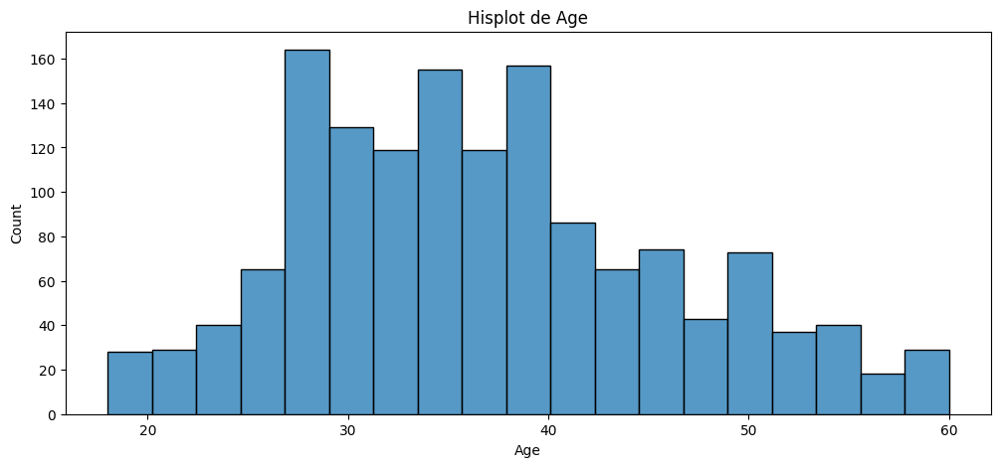

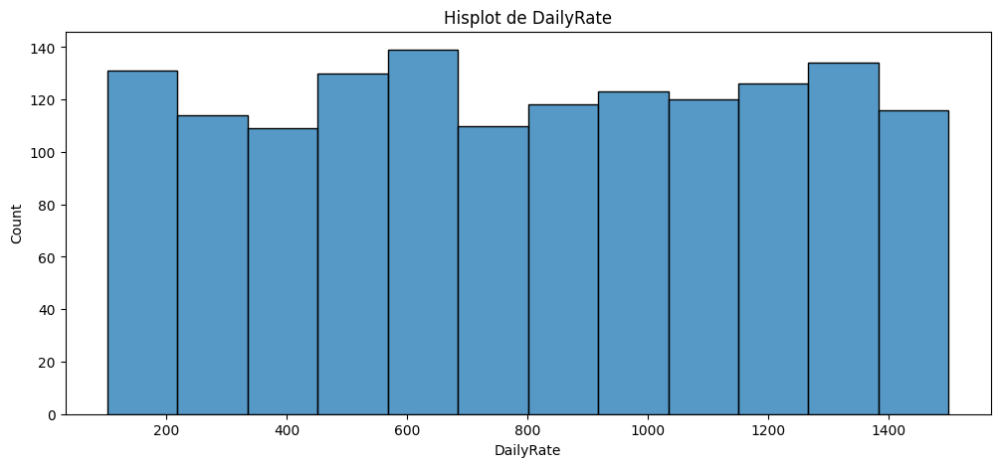

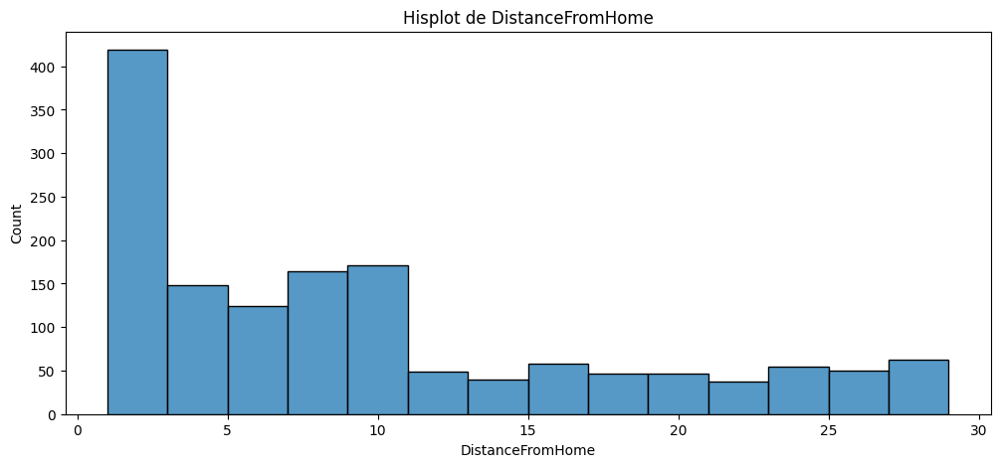

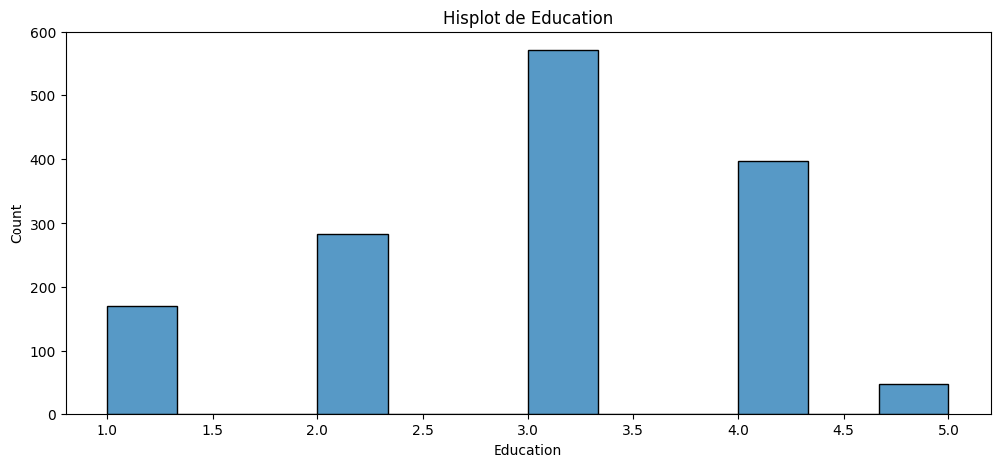

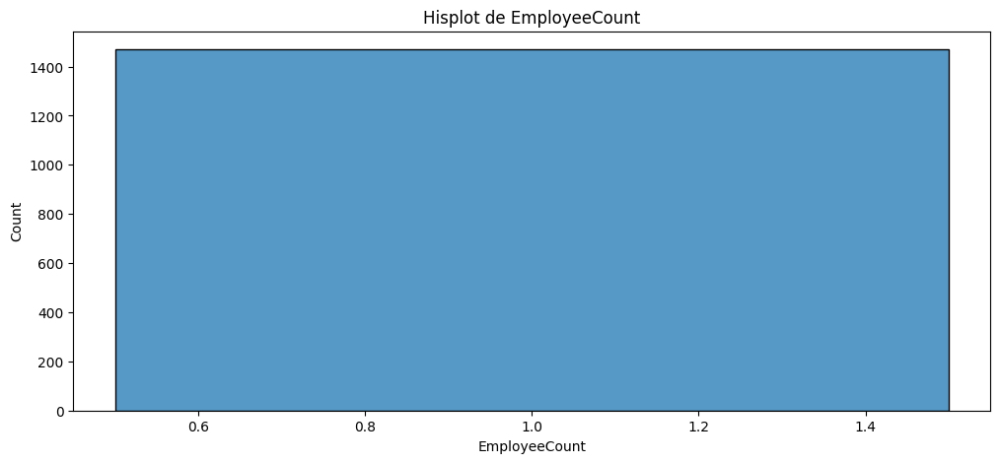

...

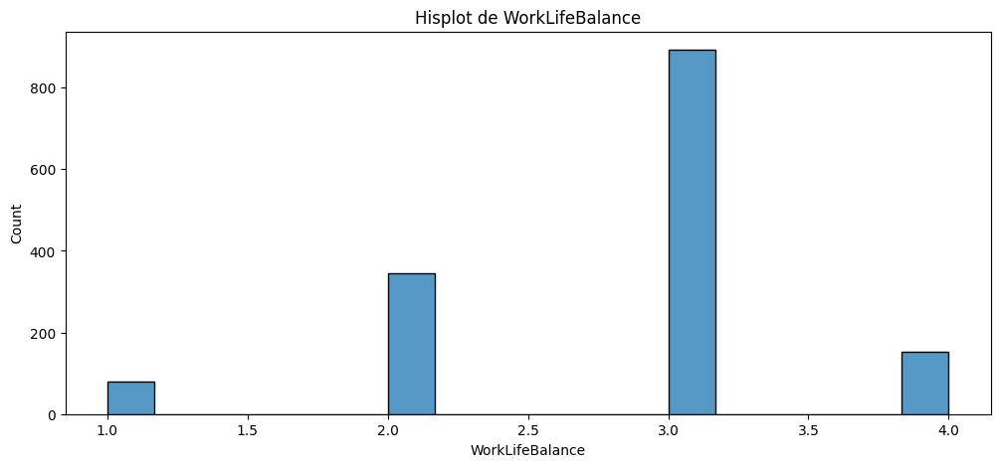

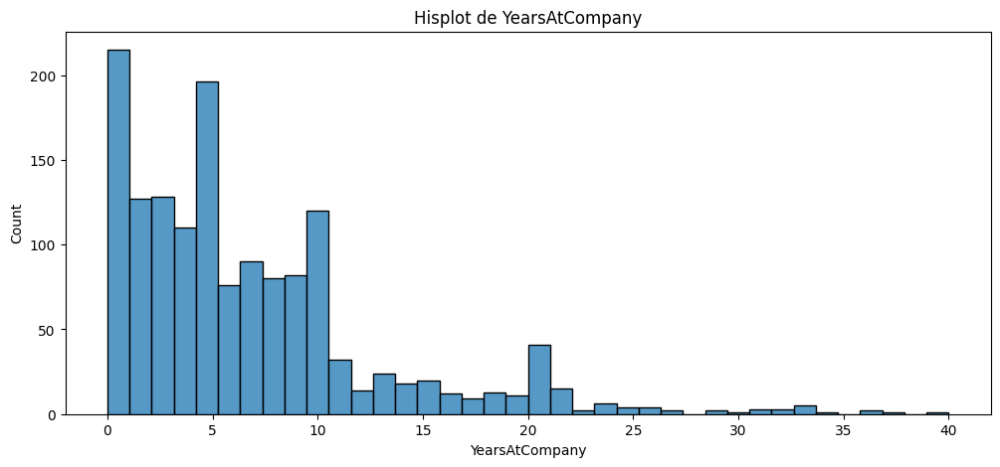

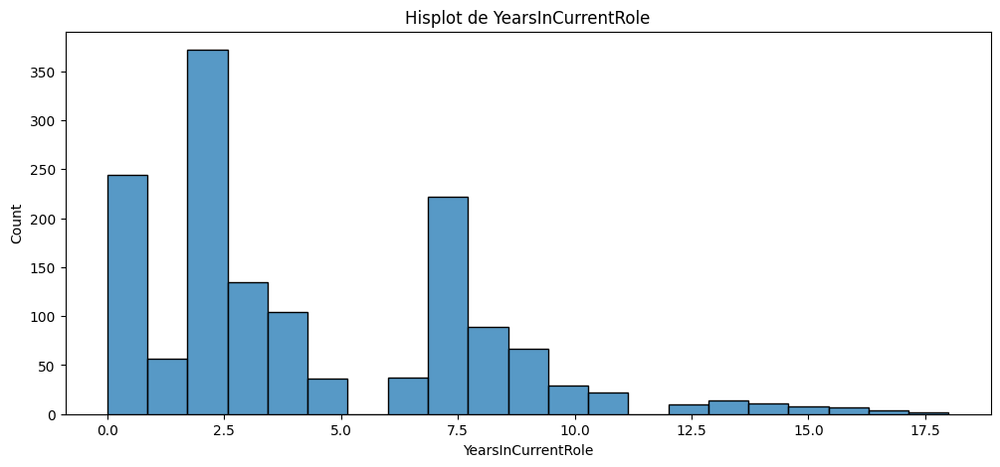

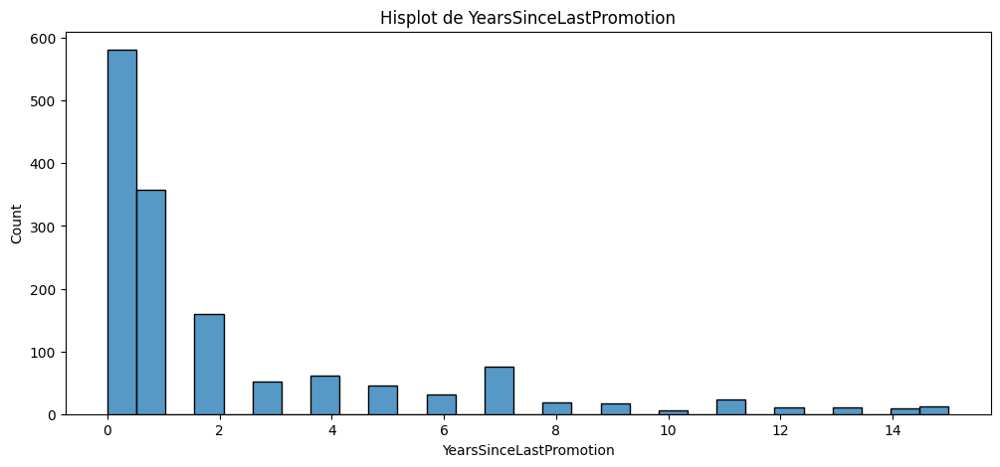

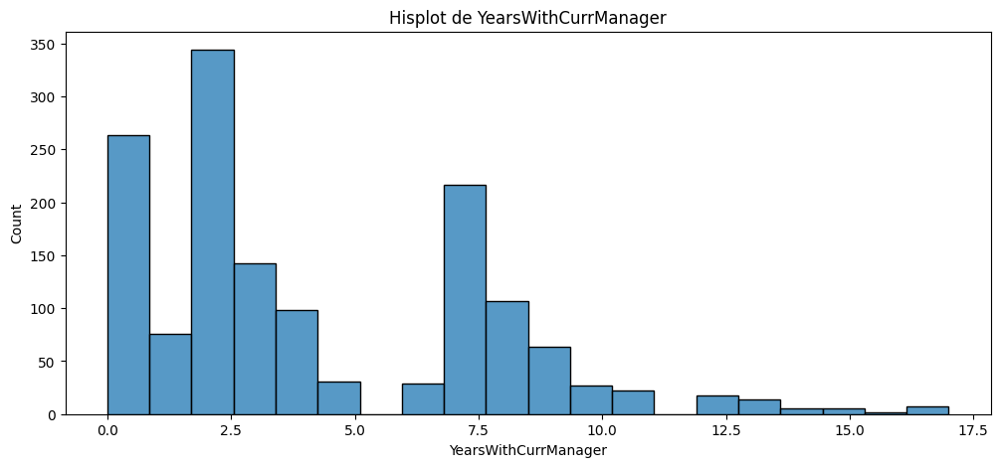

In [100]:
numeric_columns = df4.select_dtypes(include=np.number).columns.to_list()

for column in numeric_columns:
    plt.figure(figsize=(12, 5))
    sns.histplot(data=df4, x=column)
    plt.title(f'Hisplot de {column}')


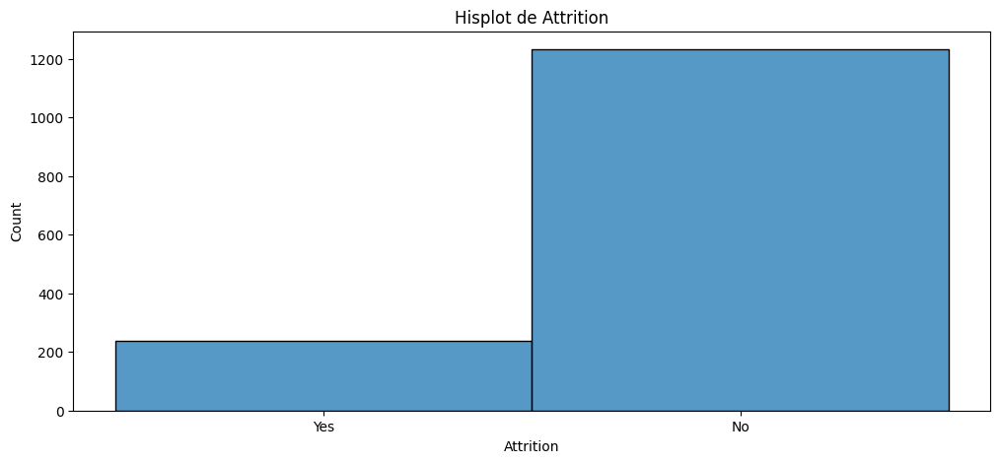

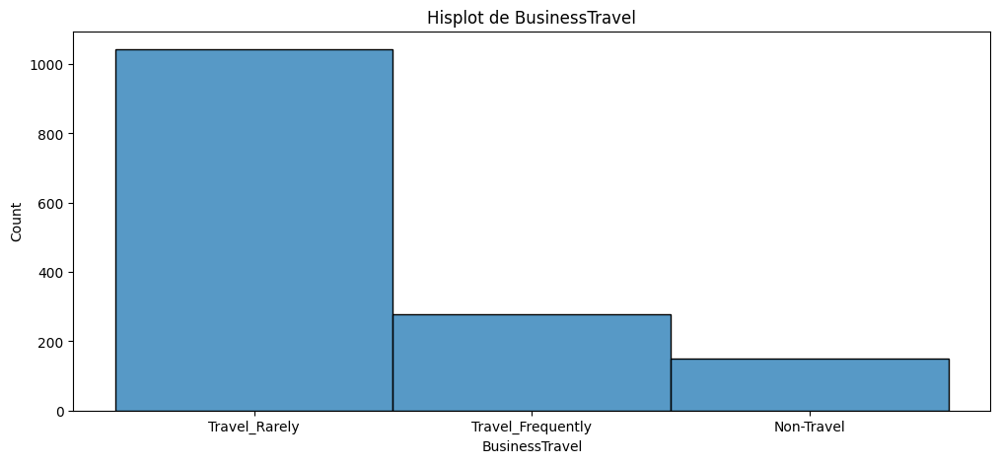

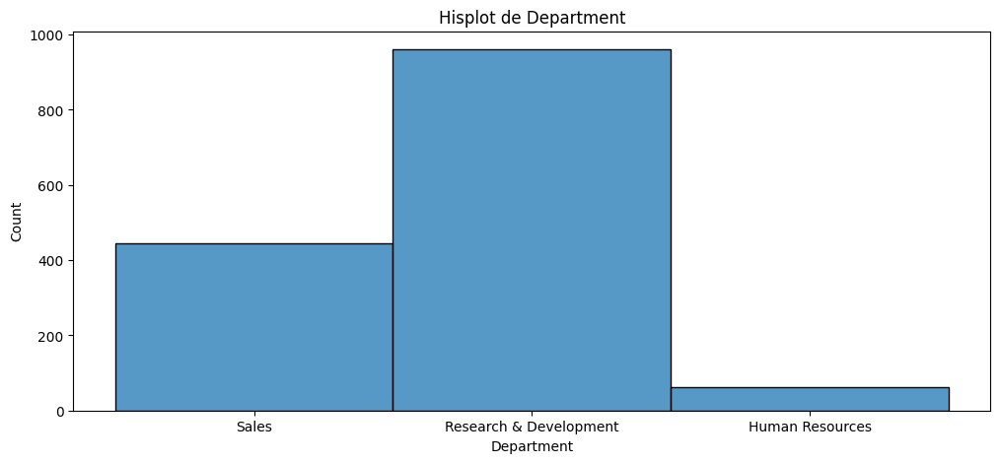

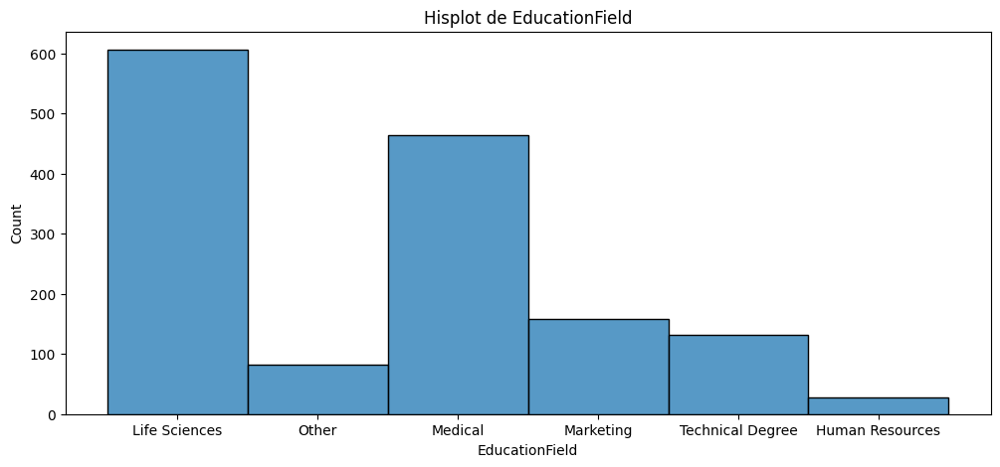

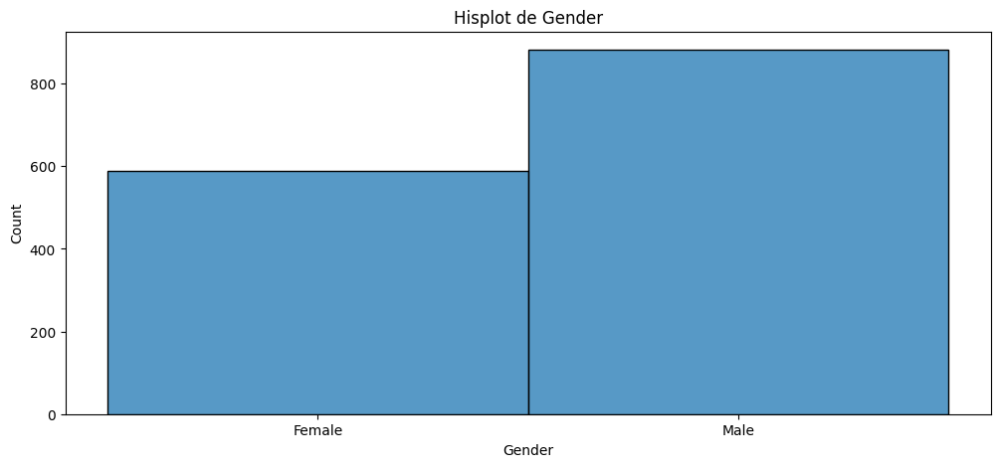

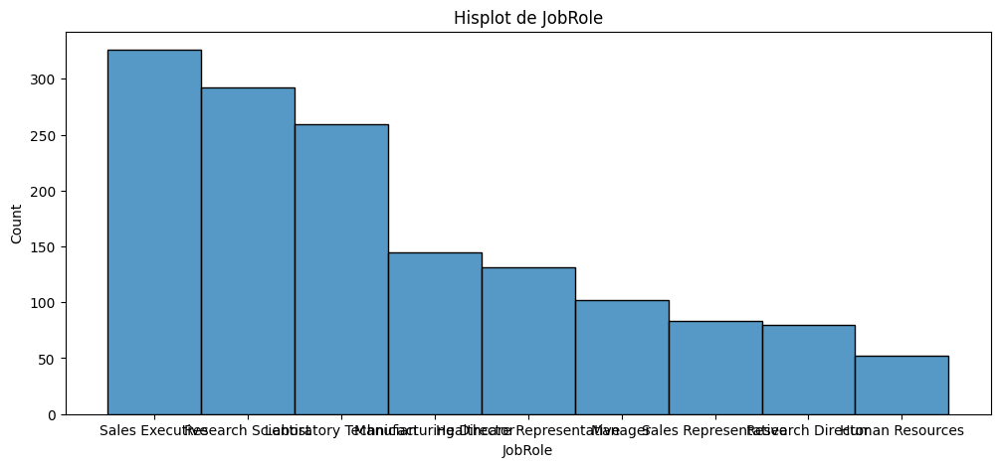

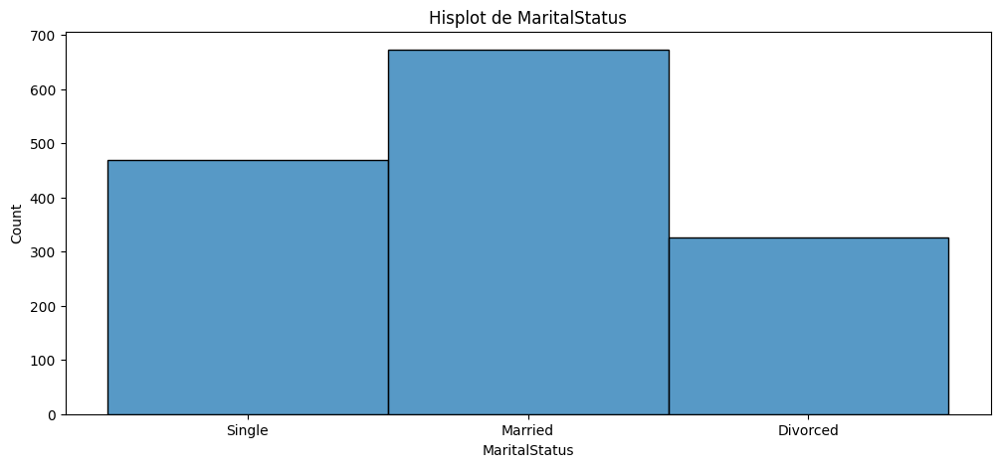

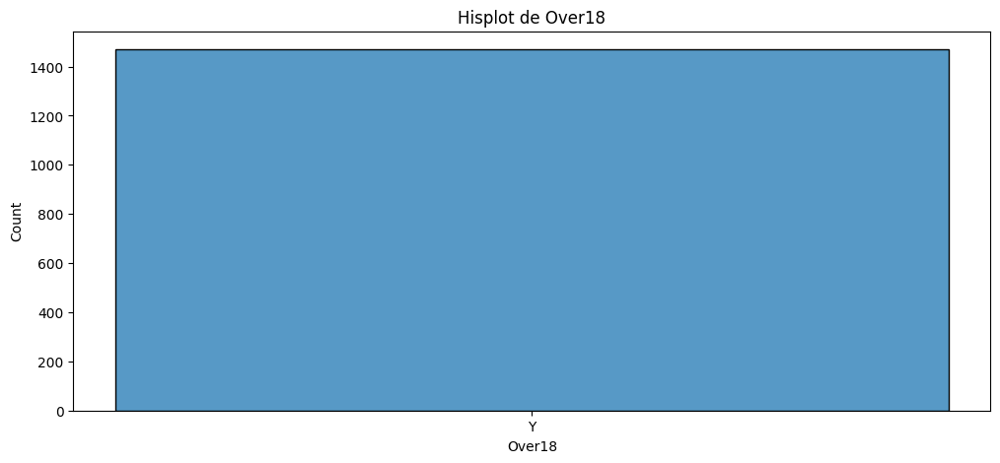

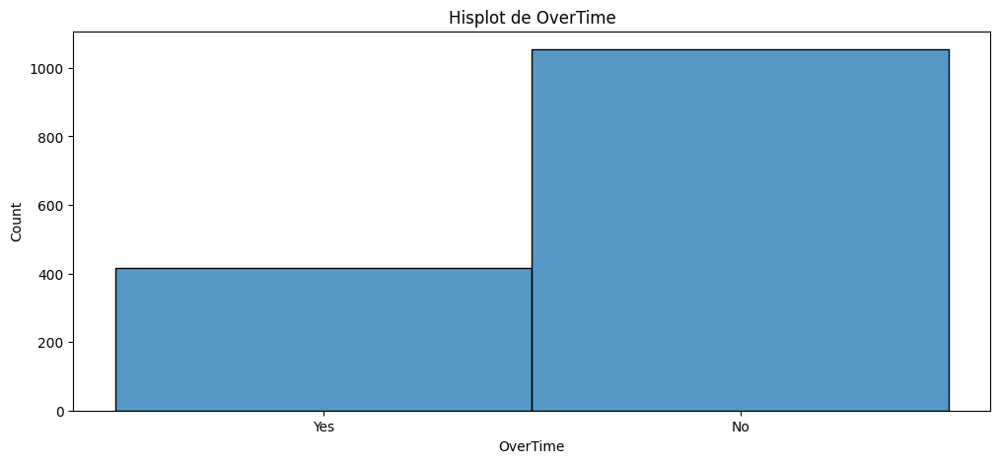

In [ ]:
text_columns = df4.select_dtypes(include='object').columns.to_list()

for column in text_columns:
    plt.figure(figsize=(12, 5))
    sns.histplot(data=df4, x=column)
    plt.title(f'Hisplot de {column}')


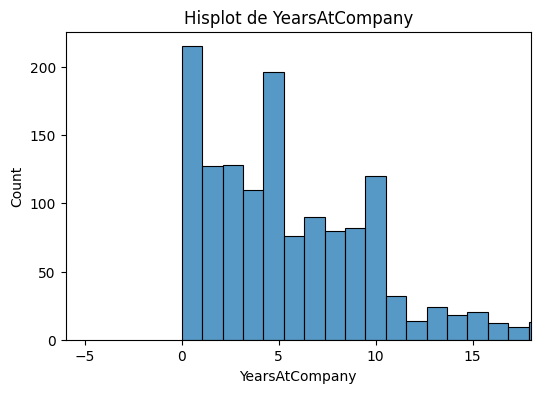

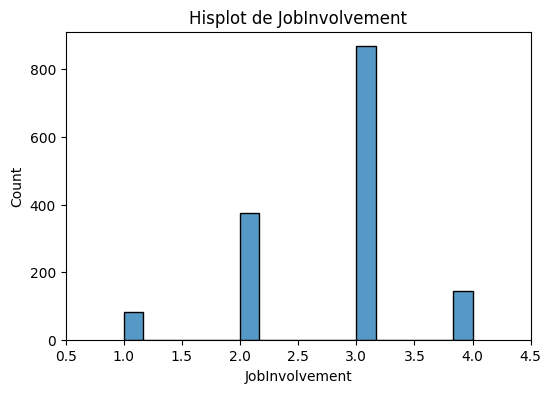

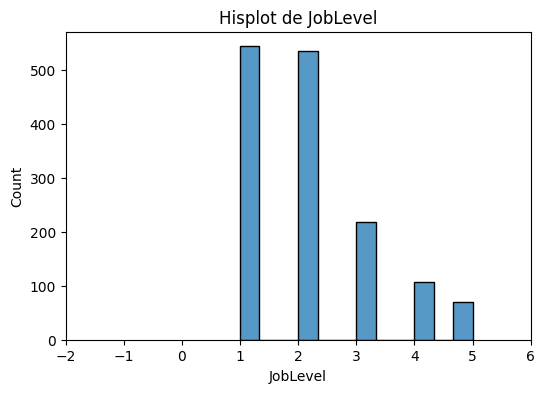

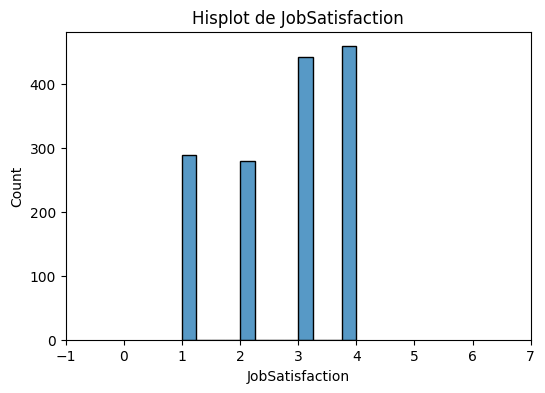

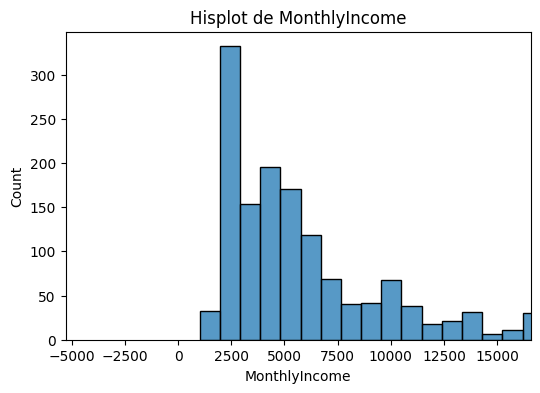

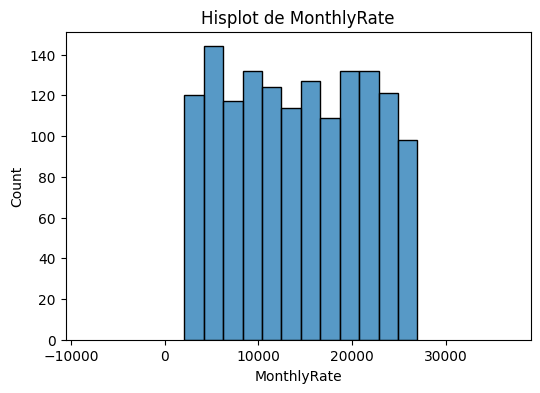

In [ ]:
numeric_columns = ['YearsAtCompany',  'JobInvolvement',
 'JobLevel',
 'JobSatisfaction',
 'MonthlyIncome',
 'MonthlyRate',]

for column in numeric_columns:
    plt.figure(figsize=(6, 4))
    sns.histplot(data=df4, x=column)
    plt.title(f'Hisplot de {column}')

    Q1 = df4[column].quantile(0.25)
    Q3 = df4[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_limit =Q1 -1.5* IQR
    upper_limit = Q3 +1.5 * IQR
    plt.xlim(lower_limit, upper_limit)
    plt.show()


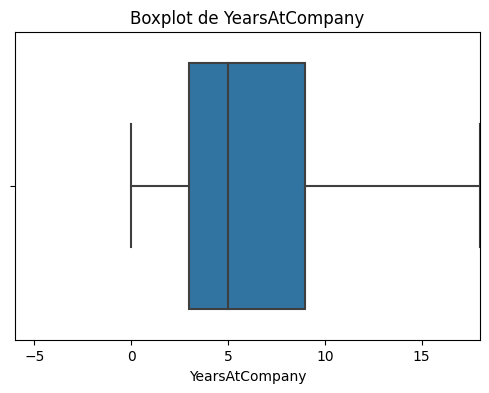

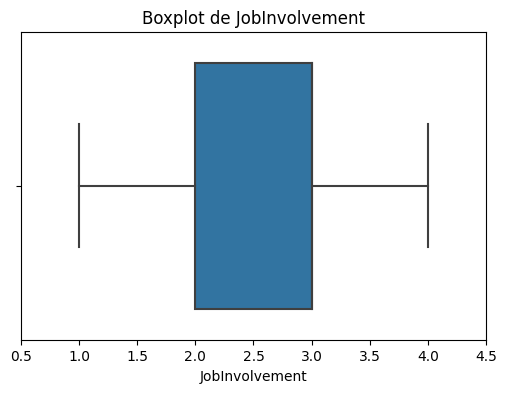

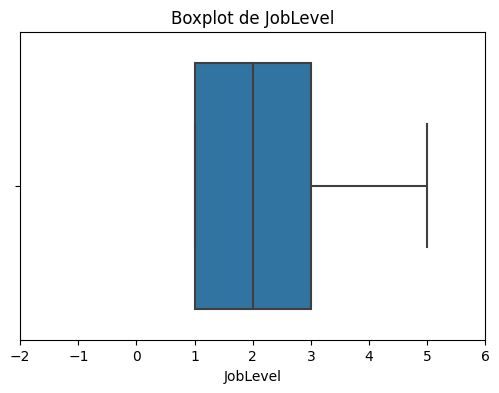

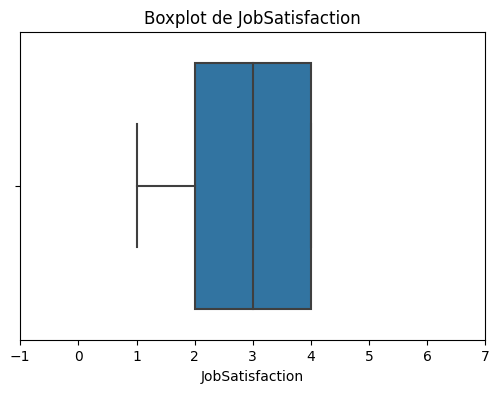

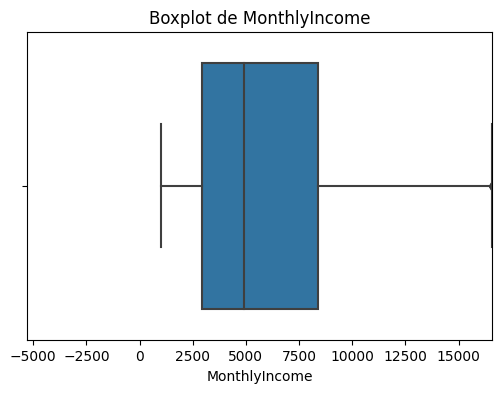

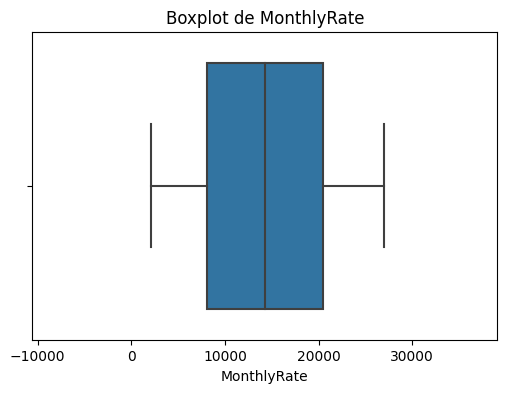

In [ ]:
numeric_columns = ['YearsAtCompany',  'JobInvolvement',
 'JobLevel',
 'JobSatisfaction',
 'MonthlyIncome',
 'MonthlyRate',]

for column in numeric_columns:
    plt.figure(figsize=(6, 4))
    sns.boxplot(data=df4, x=column)
    plt.title(f'Boxplot de {column}')

    Q1 = df4[column].quantile(0.25)
    Q3 = df4[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_limit =Q1 -1.5* IQR
    upper_limit = Q3 +1.5 * IQR
    plt.xlim(lower_limit, upper_limit)
    plt.show()

C:\Users\Jholman Cuartas\AppData\Local\Temp\ipykernel_10428\893625967.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(12, 5))


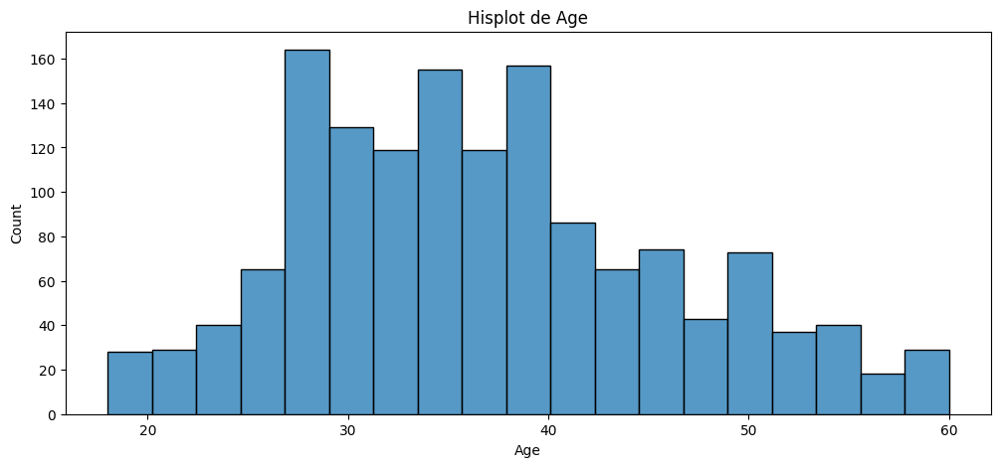

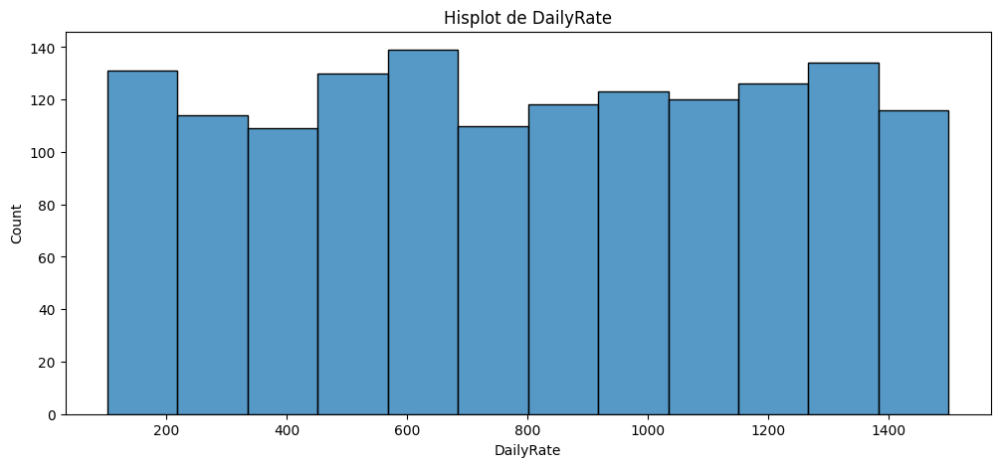

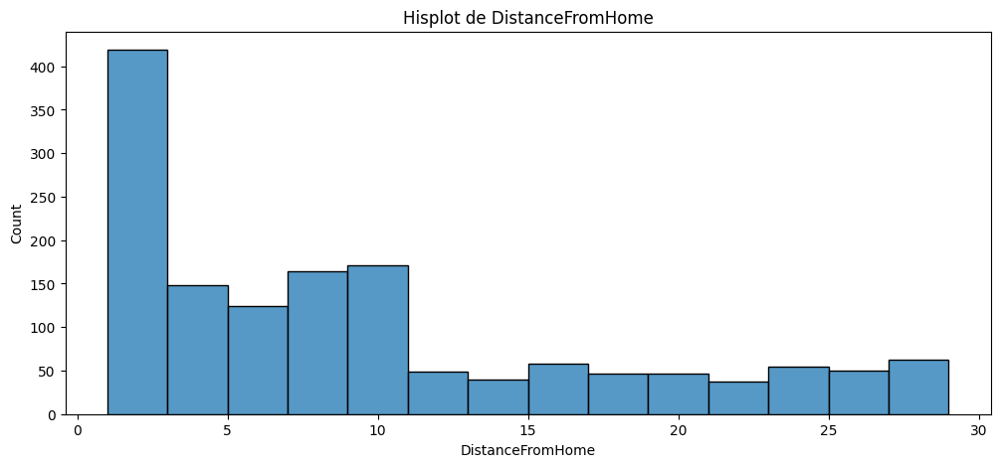

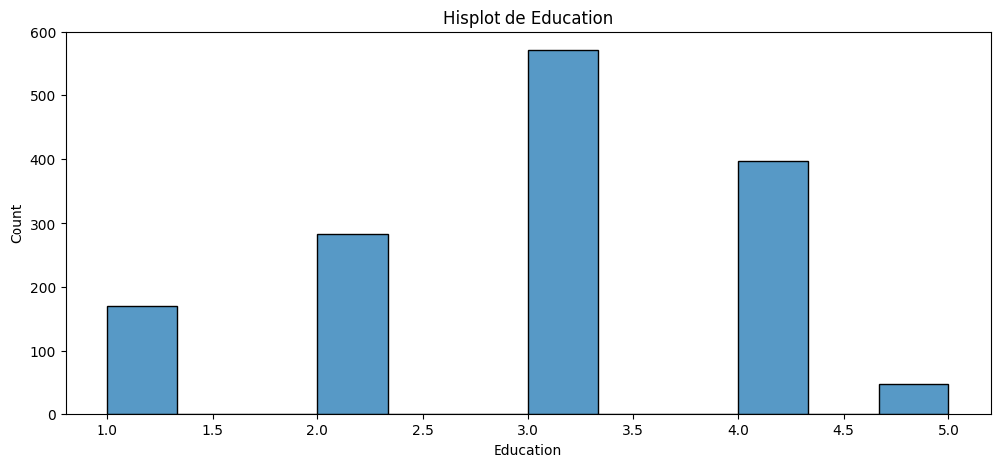

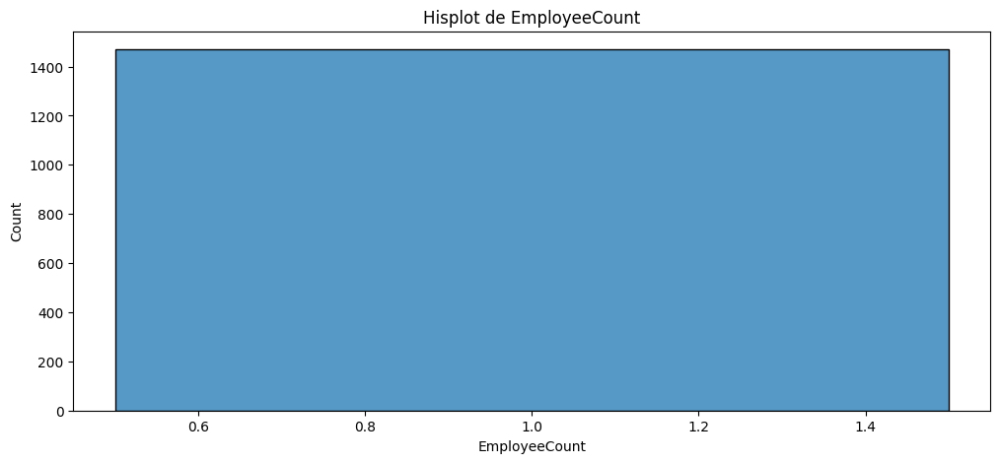

...

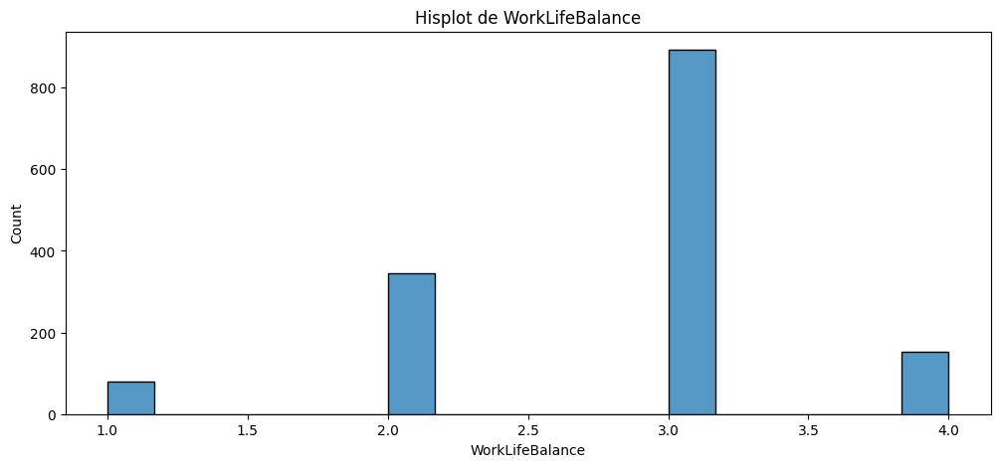

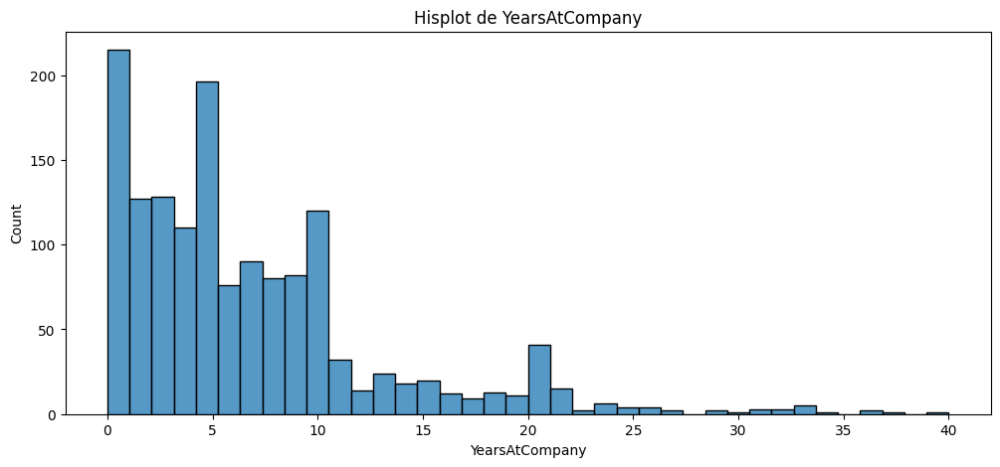

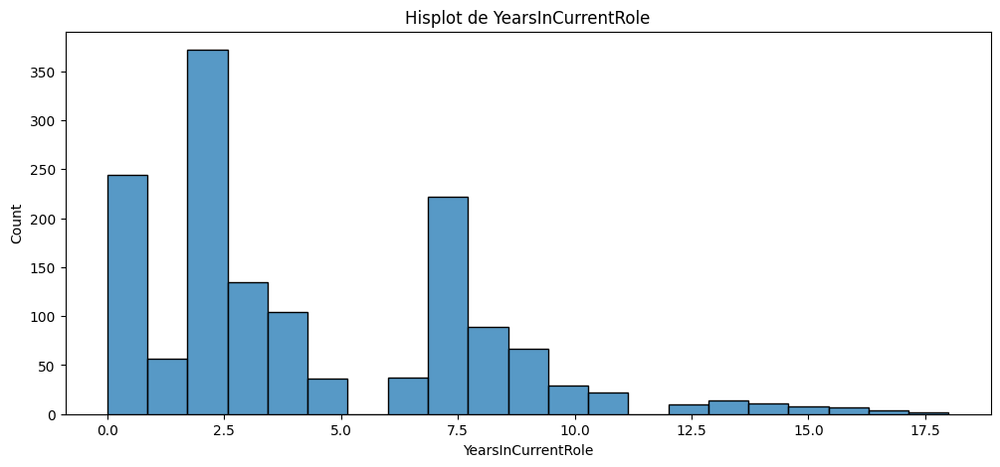

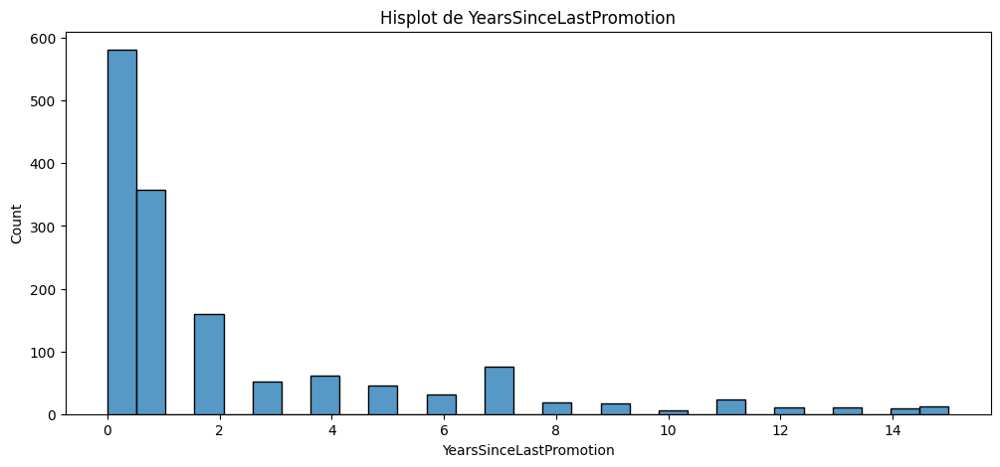

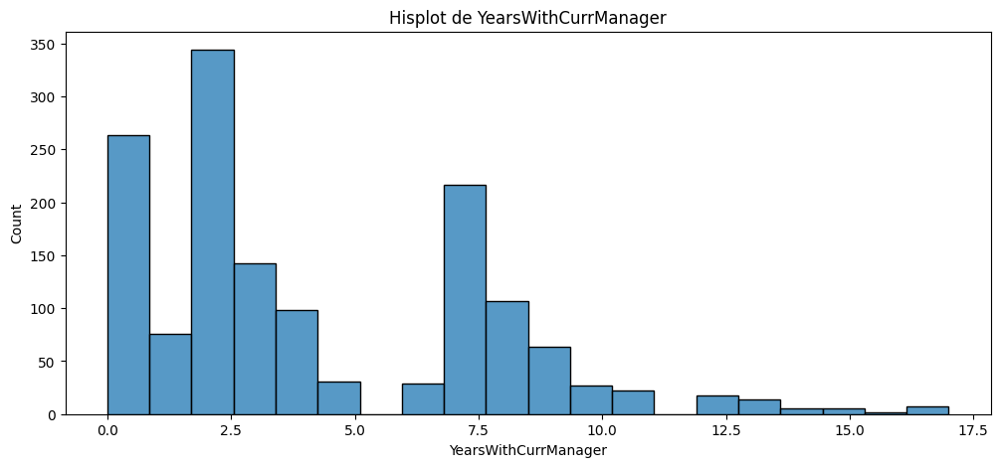

In [101]:
numeric_columns = df4.select_dtypes(include=np.number).columns.to_list()

for column in numeric_columns:
    plt.figure(figsize=(12, 5))
    sns.histplot(data=df4, x=column)
    plt.title(f'Hisplot de {column}')
    